In [2]:
## Import necessary modules 

from astropy.io import fits
from astropy.wcs import WCS
from astropy.stats import sigma_clipped_stats
import glob
import os
import subprocess
import warnings
import numpy as np
import matplotlib.pyplot as plt
import photutils
import regions  

from astropy.visualization import ZScaleInterval

## pyregion was here but chnaged by me to region

# You can ignore any warnings that appear below, but if any modules can't be imported you need to install them

In [3]:
def test_dependency(dep, alternate_name=None):
    """
    Test external dependency by trying to run it as a subprocess
    """
    try:
        subprocess.check_output(dep, stderr=subprocess.PIPE, shell=True)
        print("%s is installed properly as %s. OK" % (dep, dep))
        return 1
    except subprocess.CalledProcessError:
        try:
            subprocess.check_output(alternate_name, stderr=subprocess.PIPE, shell=True)
            print("%s is installed properly as %s. OK" % (dep, alternate_name))
            return 1
        except subprocess.CalledProcessError:
            print("===%s/%s IS NOT YET INSTALLED PROPERLY===" % (dep, alternate_name))
            return 0
    
dependencies = [('source-extractor', 'sex'), ('SWarp', 'swarp')]
i = 0
for dep_name1, dep_name2 in dependencies:
    i += test_dependency(dep_name1, dep_name2)
print("%i out of %i external dependencies installed properly.\n" % (i, len(dependencies)))
if i != len(dependencies):
    print("Please correctly install these programs before continuing by following the instructions in README.md.")
else:
    print("You are ready to continue.")        

source-extractor is installed properly as sex. OK
SWarp is installed properly as SWarp. OK
2 out of 2 external dependencies installed properly.

You are ready to continue.


In [4]:
curpath = os.path.abspath('./g_band')                    # top level directory
dataFolder = os.path.join(curpath, 'data')        # data directory
biasFolder = os.path.join(curpath, 'bias')     # bias frames subdirectory
flatFolder = os.path.join(curpath, 'flat')     # flat fields subdirectory
procFolder = os.path.join(curpath, 'processing')  # processing directory
if not os.path.isdir(procFolder): 
    os.mkdir(procFolder)
# else:
#     for f in os.listdir(procFolder):
#         try:
#             os.remove(os.path.join(procFolder,f)) # clear the processing folder from previous iterations
#         except:
#             print('Could not remove',f)

In [5]:
## Get file lists

os.chdir(dataFolder)
fileList = sorted(glob.glob('*.fits'))
os.chdir(curpath)
biasList = sorted(glob.glob(os.path.join(biasFolder,'*.fits')))
flatList = sorted(glob.glob(os.path.join(flatFolder,'*.fits')))
sciList = [os.path.join(dataFolder, file) for file in fileList]
procList = [os.path.join(procFolder, file).replace('.fits','.proc.fits') for file in fileList]
combinedFile = os.path.join(procFolder, 'SN_2023_combined.fits')
weightFile = os.path.join(procFolder, 'SN_2023_weight.fits')
resampledFile = os.path.join(procFolder, 'SN_2023_resampled.fits')

print('Found',len(biasList),'bias files; ',len(flatList),'flat files; ',len(sciList),'science files')

Found 14 bias files;  8 flat files;  30 science files


## Data 

### Supernova = 20230520151900-863-RA.fits

In [5]:
exampleFile = sciList[0]         # The first science image
HDUList = fits.open(exampleFile) # Open the file
HDUList.info()                   # Print some information about the FITS file structure.  

Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/data/20230520151900-863-RA.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     133   (4096, 4108)   int16 (rescales to uint16)   


In [6]:

header = HDUList[0].header # Get the header out of the HDU list.
print(repr(header[0:13]))  # Print the first 14 lines of the header (in raw format).
print(repr(header[24:34])) # Print some additional lines
print(repr(header[48:52])) 
print(repr(header[67:71])) 
print(repr(header[129:135])) 
print()


SIMPLE  =                    T / conform to FITS standard                       
BITPIX  =                   16 / unsigned short data                            
NAXIS   =                    2 / number of axes                                 
NAXIS1  =                 4096 / length of data axis                            
NAXIS2  =                 4108 / length of data axis                            
EXTEND  =                    T / this is FITS with extensions                   
HISTORY Created with RTS2 version 0.9.5 build on May 12 2020 19:07:30.          
CTIME   =           1684595940 / exposure start (seconds since 1.1.1970)        
USEC    =               863089 / exposure start micro seconds                   
JD      =     2460085.13819481 / Modified Julian Date                           
DATE-OBS= '2023-05-20T15:19:00.863' / start of exposure                         
EXPOSURE=                  60. / exposure length in seconds                     
EXPTIME =                  6

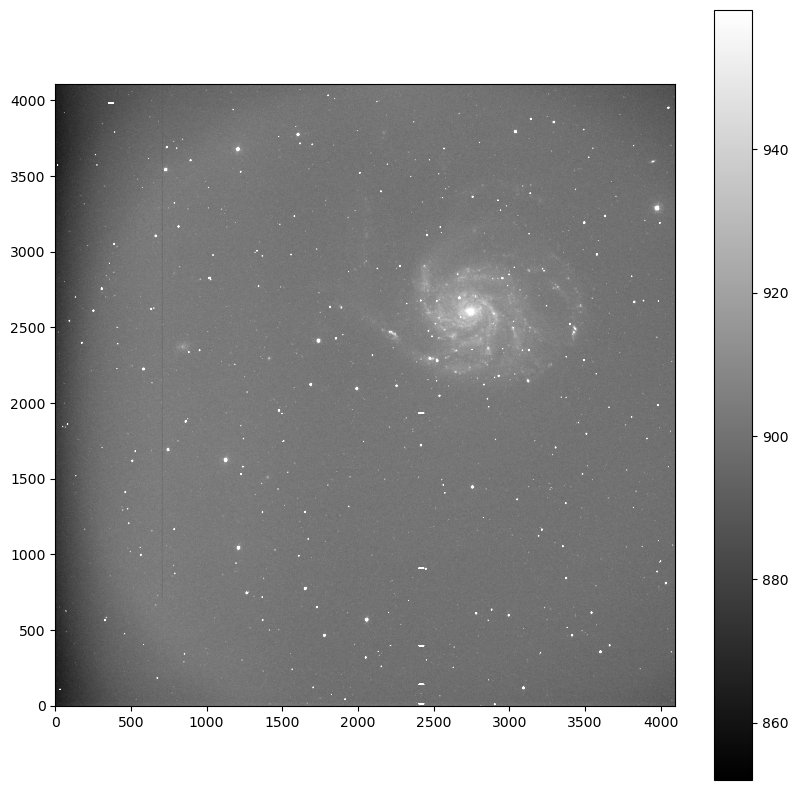

In [7]:
data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.

# mean, median, std = sigma_clipped_stats(data) # get some image statistics
plt.figure(figsize=(10,10))                     # set up the plot panel
# plt.imshow(data, vmin = median - 2*std, vmax = median + 20*std, origin='lower')
# plt.imshow(procData, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
# plt.colo rbar()
# plt.show()



zx = ZScaleInterval().get_limits(data)
plt.imshow(data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()

## Bias

Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/bias/20230520_masterbias.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     111   (4096, 4108)   float64   


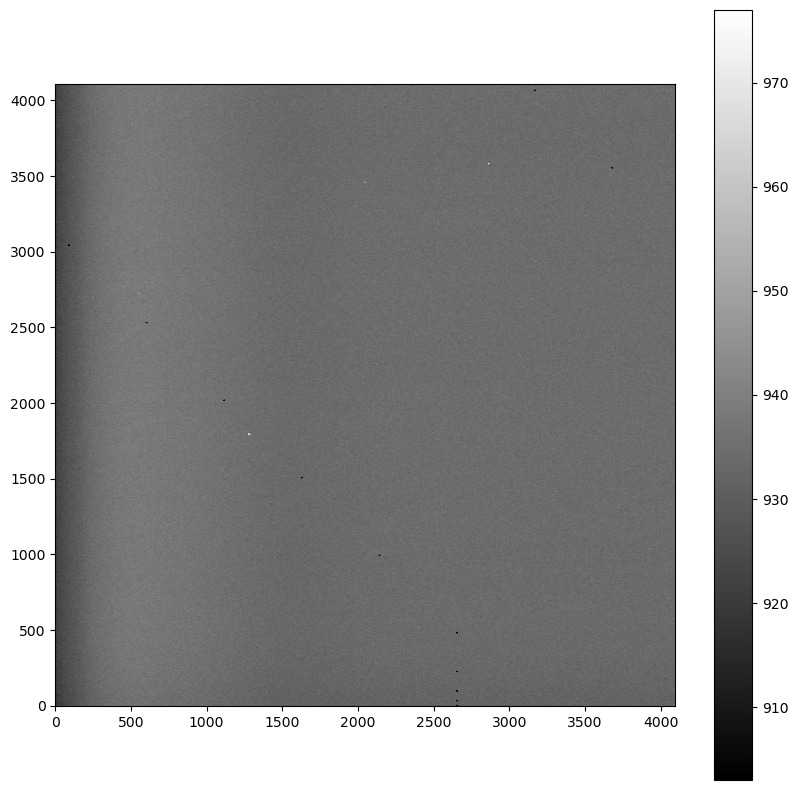

In [8]:

bias_image = biasList[0]
HDUList = fits.open(bias_image)
data = HDUList.info()

bias_data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.

# mean, median, std = sigma_clipped_stats(bias_data) # get some image statistics
plt.figure(figsize=(10,10))                     # set up the plot panel
# plt.imshow(bias_data, vmin = median - 2*std, vmax = median + 20*std, origin='lower')
# plt.colorbar()
# plt.show()

zx = ZScaleInterval().get_limits(bias_data)
plt.imshow(bias_data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()

## Flat

Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/flat/masterflat_g_.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     121   (4096, 4108)   float64   


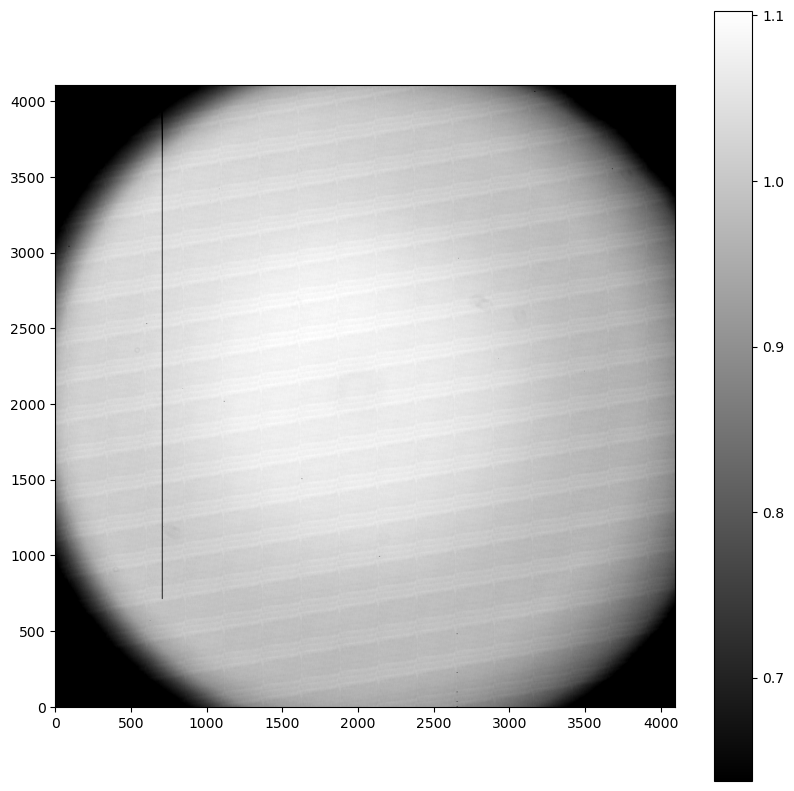

In [9]:
flat_image = flatList[-1]
HDUList = fits.open(flat_image)
data = HDUList.info()

flat_data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.

# mean, median, std = sigma_clipped_stats(flat_data) # get some image statistics
plt.figure(figsize=(10,10))                     # set up the plot panel
# plt.imshow(flat_data, vmin = median - 2*std, vmax = median + 20*std, origin='lower')
# plt.colorbar()
# plt.show()              # Close the file (good practice, but not strictly necessary)

zx = ZScaleInterval().get_limits(flat_data)
plt.imshow(flat_data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()

In [10]:
flat_corrected  = flat_data 
# Bias-subtract, normalize, and add to the array layer
# flat_data -= bias_data
normfactor = np.median(flat_data)
print(normfactor)
flat_corrected[:,:] = flat_data / normfactor


1.0


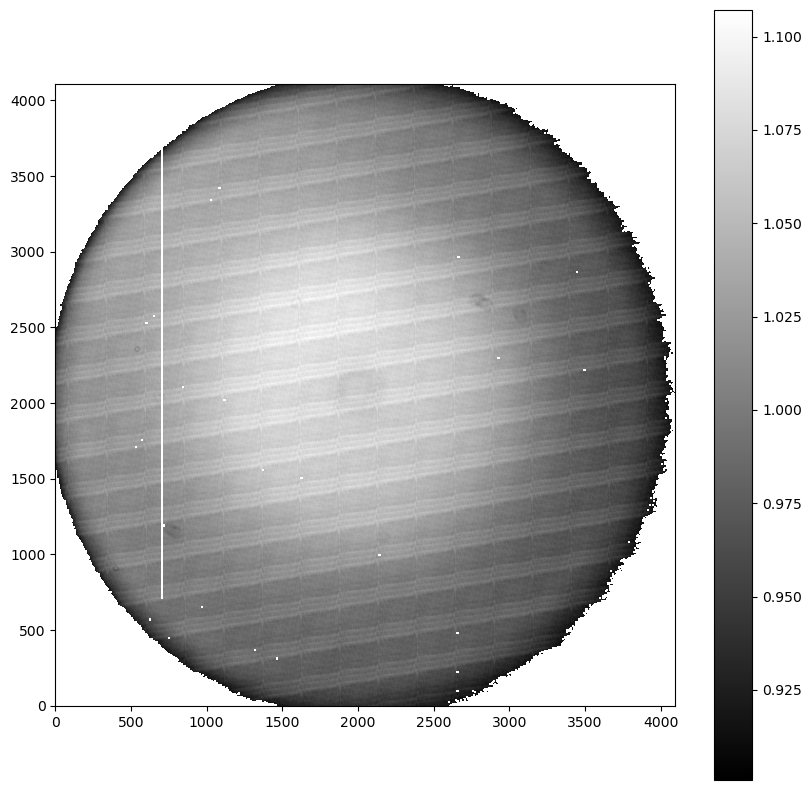

In [11]:
masterFlatFixed = np.copy(flat_corrected) # Use 'copy' to preserve the original masterFlat
if np.any(flat_corrected < 0.9):
        # Set all flat-field values lower than 0.2 to NaN
        masterFlatFixed[flat_corrected < 0.9] = float('NaN') 

plt.figure(figsize=(10,10))
#scale the image according to its statistics
# plt.imshow(masterFlatFixed, vmin = 0, vmax = median + 5*std, origin='lower')
# plt.colorbar()
# plt.show()

zx = ZScaleInterval().get_limits(masterFlatFixed)
plt.imshow(masterFlatFixed, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()

In [12]:


HDUList = fits.open(sciList[0])
primaryHeader = HDUList[0].header
imageData = HDUList[0].data    
HDUList.close()
        
        # Correct for the bias and flats here
procData = (imageData - bias_data) / masterFlatFixed
        
        # Prepare the output FITS structure in simple format
procHDU = fits.PrimaryHDU(procData)  # Create a new HDU with the processed image data

        # Write the reduced frame to disk
print(sciList[0],'->',procList[0])
procHDU.writeto(procList[0], overwrite=True)
        

/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/data/20230520151900-863-RA.fits -> /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230520151900-863-RA.proc.fits


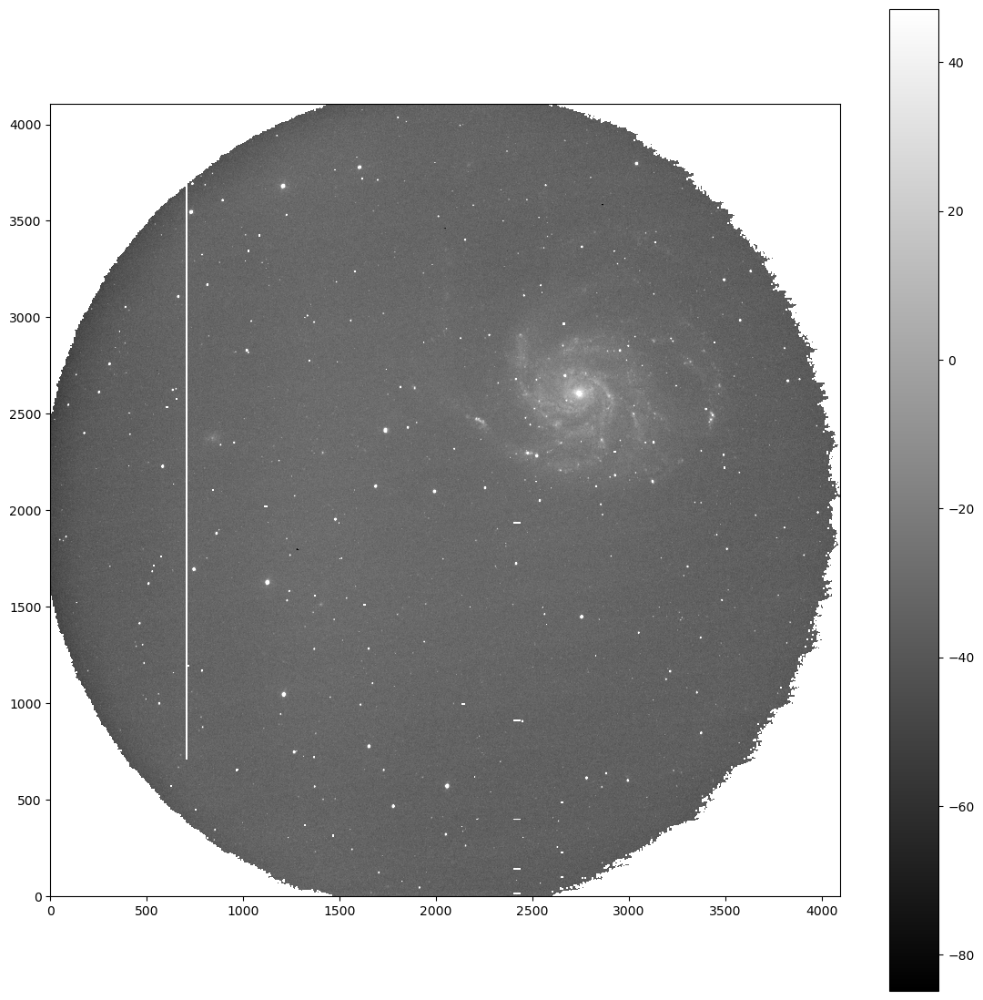

In [13]:

plt.figure(figsize=(14,14))

procHDU = fits.open(procList[0])
procData = procHDU[0].data
procHDU.close()
        
# mean, median, std = sigma_clipped_stats(procData)
# plt.subplot(2,2,1+i)
# plt.imshow(procData, vmin = median - 2*std, vmax = median + 5*std, origin='lower')
# plt.colorbar()

zx = ZScaleInterval().get_limits(procData)
plt.imshow(procData, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()


## Astrometry 

In [31]:

# from astrometry_net_client import Session
# from astrometry_net_client import FileUpload

# # I have done it for a single file, do it for the combined file you created last time

# s = Session(api_key='tcxcjiptjfljusuj')
# upl = FileUpload('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230520151900-863-RA.proc.fits', session=s)
# submission = upl.submit()
# submission.until_done()
# job = submission.jobs[0]
# job.until_done()

# if job.success():
#     wcs = job.wcs_file()     
#     corrTable2 = job.corr_file() # contains the positions in pixel coordinates of the stars detected
#     astromFile = job.new_fits_file() # contains the original file you uploaded with the header containing the transformation matrix

#     corrTable2.writeto('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/corr2-20230520151900-863-RA.proc.fits', overwrite=True)
#     astromFile.writeto('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/acam762-20230520151900-863-RA.proc.fits', overwrite=True)      

# print(job.info())

KeyboardInterrupt: 

In [14]:
from astropy.table import Table
corr2 = fits.open('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/corr2-20230520151900-863-RA.fits')

data = corr2[1].data
table = Table(data)

print(table)

     field_x            field_y       ...    FLUX   BACKGROUND
------------------ ------------------ ... --------- ----------
1126.2528076171875  1627.093994140625 ... 22078.982 -30.138672
   2057.1142578125  572.7163696289062 ... 16002.741 -33.969727
1211.0379638671875 1046.7947998046875 ...  14651.21 -31.299805
1603.5269775390625  3775.702392578125 ... 11677.365  -31.33496
 2753.429931640625  1448.074462890625 ...  6243.835 -32.293457
1019.6890869140625   2827.92236328125 ... 1751.5897 -31.521118
    3574.201171875    2983.1123046875 ... 1406.5879 -35.060547
 2778.734130859375  613.8372802734375 ... 1169.2474 -35.003784
 1991.085693359375  2097.757080078125 ...   4916.56 -30.097168
 584.0968017578125  2227.075439453125 ... 2690.5205 -33.024902
               ...                ... ...       ...        ...
 2557.595458984375  3358.278076171875 ...  68.12518 -32.698257
   2366.7861328125  3858.745361328125 ... 75.724014  -32.91793
1451.6832275390625 1031.4847412109375 ... 71.138756 -30

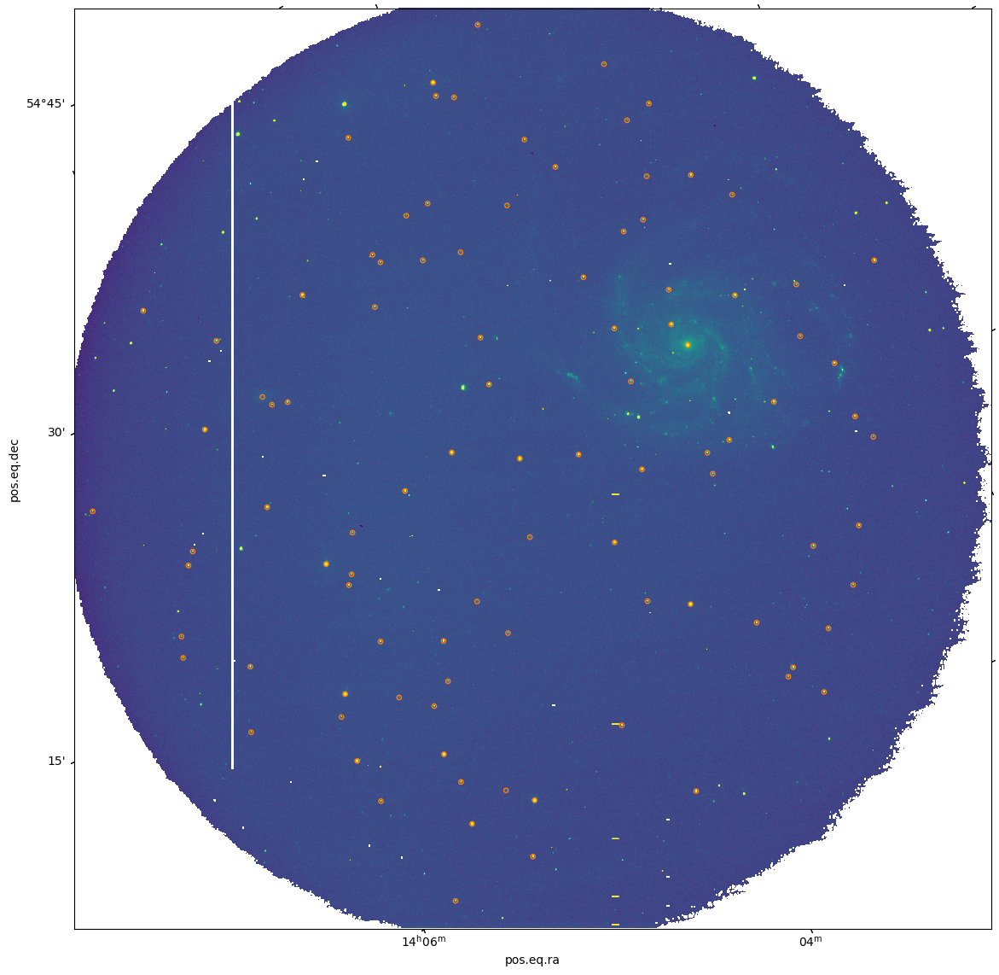

In [15]:
from matplotlib.patches import Circle

astromFile = '/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230520151900-863-RA.proc.fits'

with fits.open(astromFile) as HDUList:
    img = HDUList[0].data
    header = HDUList[0].header

wcsFile = '//Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/wcs-20230520151900-863-RA.fits'
with fits.open(wcsFile) as HDUList:
    header = HDUList[0].header

wcs = WCS(header) # the following obtains the transformation matrix from the header

ra = data['field_ra']
dec = data['field_dec']

# changing the coordinates of reference stars from WCS to pixels using tranformation obtained by solving astrometry
coordsx, coordsy = wcs.all_world2pix(ra, dec, 0) 

patch_list = [Circle((x, y), radius=10, fill=False, ec='C1') for x, y in zip(coordsx, coordsy)]

fig = plt.figure(figsize=(14,14))
ax = plt.subplot(projection=wcs) # changes the coordinate system to WCS
mean, median, std = sigma_clipped_stats(img)

plt.imshow(img, vmin=median-3*std, vmax=median+10*std, origin="lower")

for p in patch_list:
    ax.add_patch(p)

plt.show()

# 20230524180955-720-RA.fits

Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/data/20230524180955-720-RA.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     133   (4096, 4108)   int16 (rescales to uint16)   
Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/bias/20230524_masterbias.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     111   (4096, 4108)   float64   
Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/flat/20230524_masterflat_g_.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     121   (4096, 4108)   float64   
1.0
/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-ba

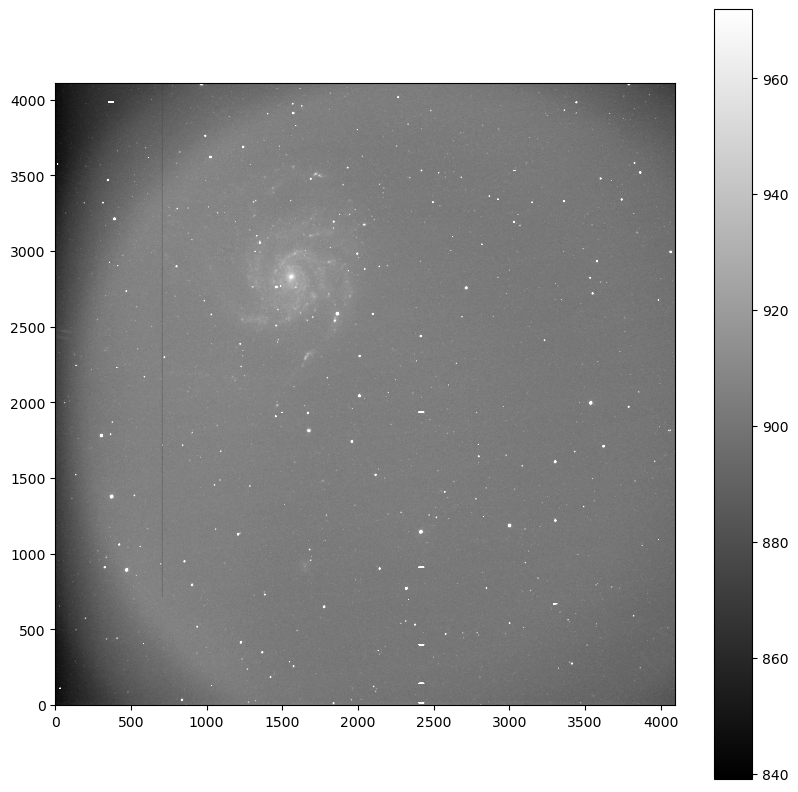

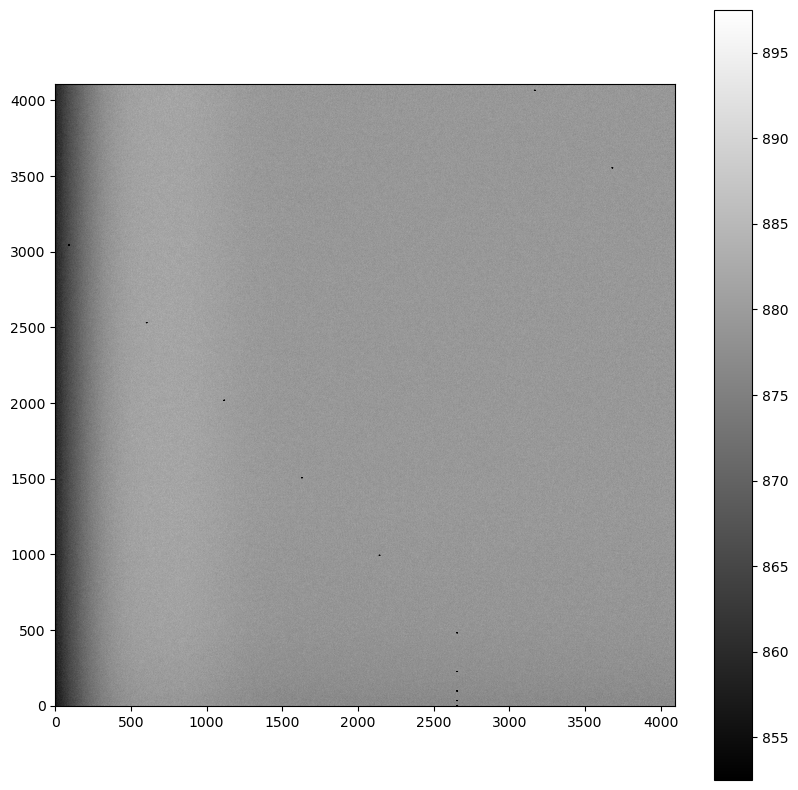

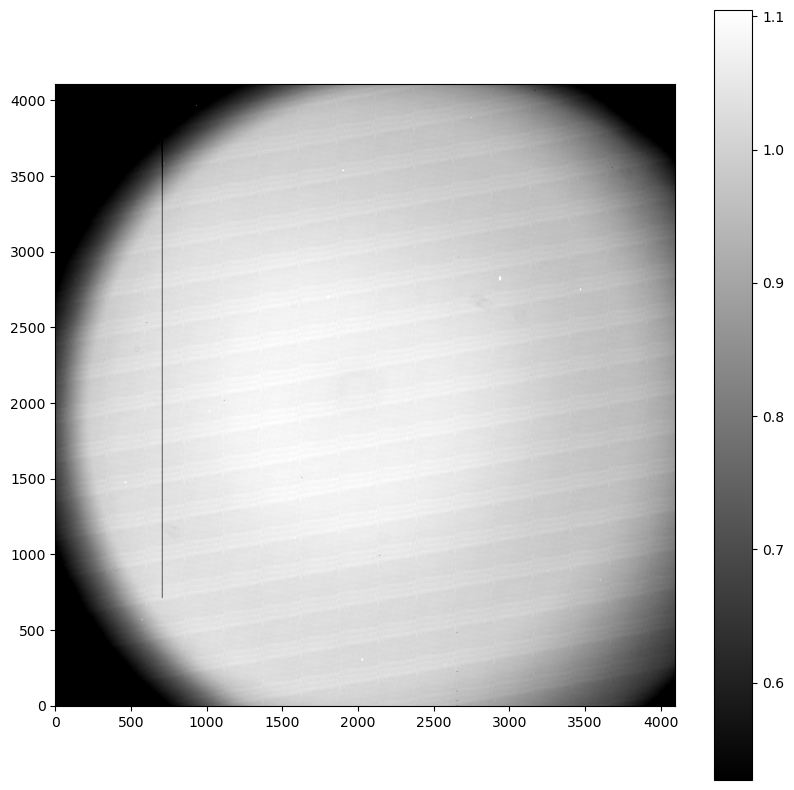

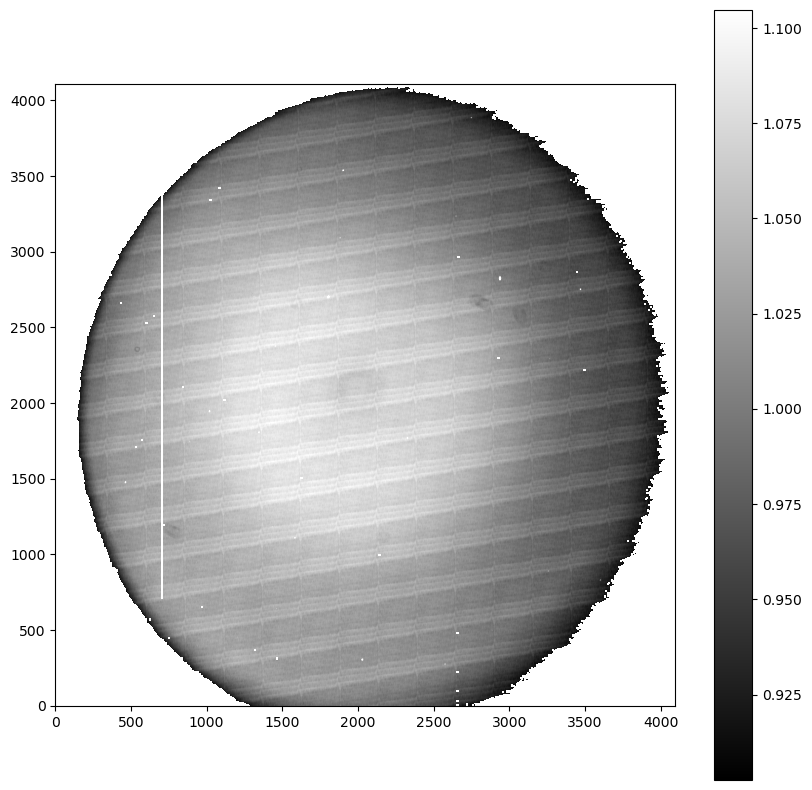

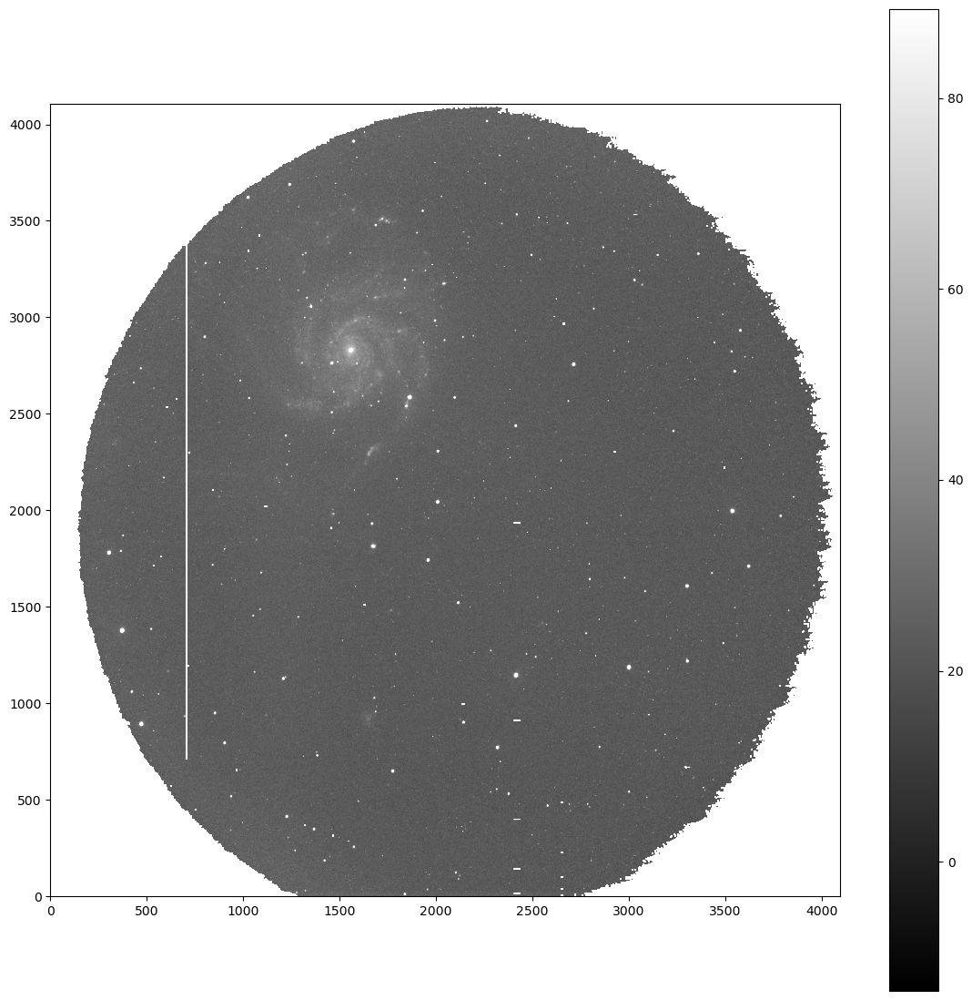

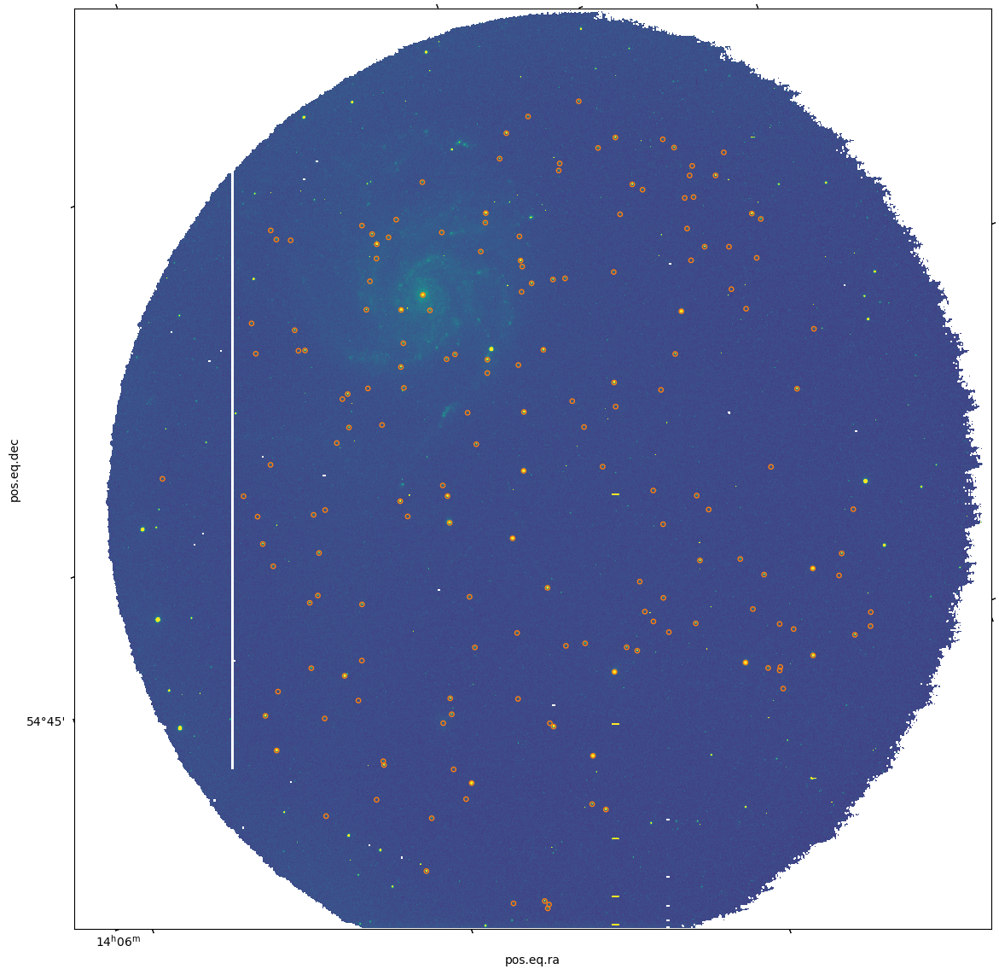

In [29]:
exampleFile = sciList[6]         # The first science image
HDUList = fits.open(exampleFile) # Open the file
HDUList.info()                   # Print some information about the FITS file structure. 
data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.


plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(data)
plt.imshow(data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar() 

## Bias Image


bias_image = biasList[4]
HDUList = fits.open(bias_image)
data = HDUList.info()

bias_data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.

plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(bias_data)
plt.imshow(bias_data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()

## Flat Image

flat_image = flatList[0]
HDUList = fits.open(flat_image)
data = HDUList.info()
flat_data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.

plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(flat_data)
plt.imshow(flat_data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()

## Normalising and displaying Flat Image

flat_corrected  = flat_data 
normfactor = np.median(flat_data)
print(normfactor)
flat_corrected[:,:] = flat_data / normfactor

masterFlatFixed = np.copy(flat_corrected) # Use 'copy' to preserve the original masterFlat
if np.any(flat_corrected < 0.9):
        # Set all flat-field values lower than 0.2 to NaN
        masterFlatFixed[flat_corrected < 0.9] = float('NaN') 

plt.figure(figsize=(10,10))
zx = ZScaleInterval().get_limits(masterFlatFixed)
plt.imshow(masterFlatFixed, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()



HDUList = fits.open(sciList[6])
primaryHeader = HDUList[0].header
imageData = HDUList[0].data    
HDUList.close()
        
        # Correct for the bias and flats here
procData = (imageData - bias_data) / masterFlatFixed
        
        # Prepare the output FITS structure in simple format
procHDU = fits.PrimaryHDU(procData)  # Create a new HDU with the processed image data

        # Write the reduced frame to disk
print(sciList[6],'->',procList[6])
fits.writeto('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230524180955-720-RA.proc.fits', procData ,overwrite=True) 

plt.figure(figsize=(14,14))

procHDU = fits.open('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230524180955-720-RA.proc.fits')
procData = procHDU[0].data
procHDU.close()
zx = ZScaleInterval().get_limits(procData)
plt.imshow(procData, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()


## Astrometry

from astropy.table import Table
corr2 = fits.open('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/corr2-20230524180955-720-RA.fits')

data = corr2[1].data
table = Table(data)

print(table)

## Plotting Astrometrically Corrected Image

from matplotlib.patches import Circle

astromFile = '/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230524180955-720-RA.proc.fits'

with fits.open(astromFile) as HDUList:
    img = HDUList[0].data
    header = HDUList[0].header

wcsFile = '//Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/wcs-20230524180955-720-RA.fits'
with fits.open(wcsFile) as HDUList:
    header = HDUList[0].header

wcs = WCS(header) # the following obtains the transformation matrix from the header

ra = data['field_ra']
dec = data['field_dec']

# changing the coordinates of reference stars from WCS to pixels using tranformation obtained by solving astrometry
coordsx, coordsy = wcs.all_world2pix(ra, dec, 0) 

patch_list = [Circle((x, y), radius=10, fill=False, ec='C1') for x, y in zip(coordsx, coordsy)]

fig = plt.figure(figsize=(14,14))
ax = plt.subplot(projection=wcs) # changes the coordinate system to WCS
mean, median, std = sigma_clipped_stats(img)

plt.imshow(img, vmin=median-3*std, vmax=median+10*std, origin="lower")

for p in patch_list:
    ax.add_patch(p)

plt.show()

# 20230525184701-216-RA.fits

Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/data/20230525184701-216-RA.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     133   (4096, 4108)   int16 (rescales to uint16)   
Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/bias/20230525_masterbias.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     111   (4096, 4108)   float64   
Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/flat/20230525_masterflat_g_.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     121   (4096, 4108)   float64   
1.0
     field_x            field_y       ...    FLUX     BACKGROUND 
------------------ ------------------ ... 

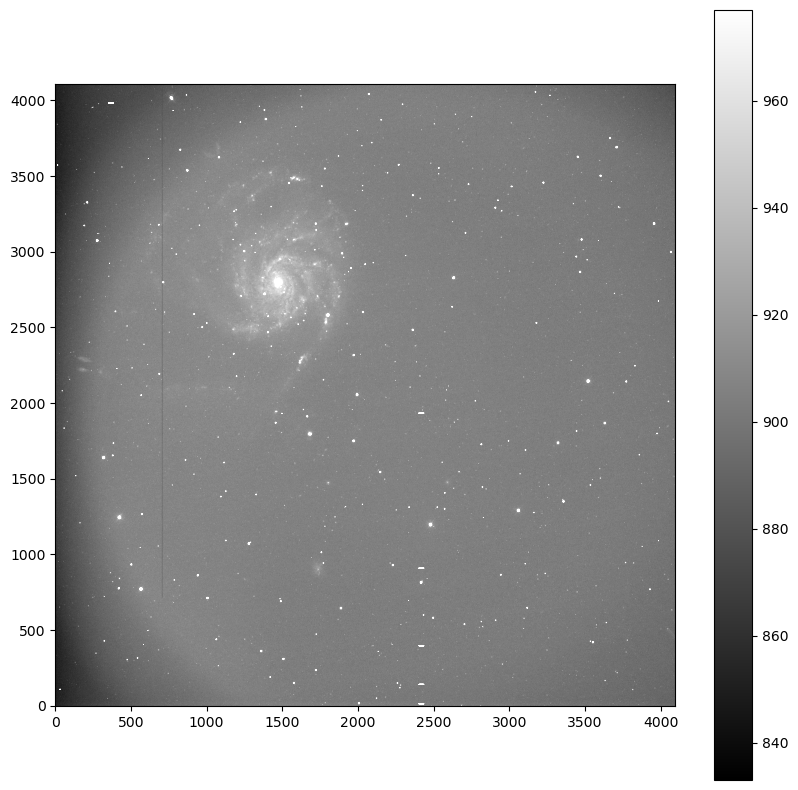

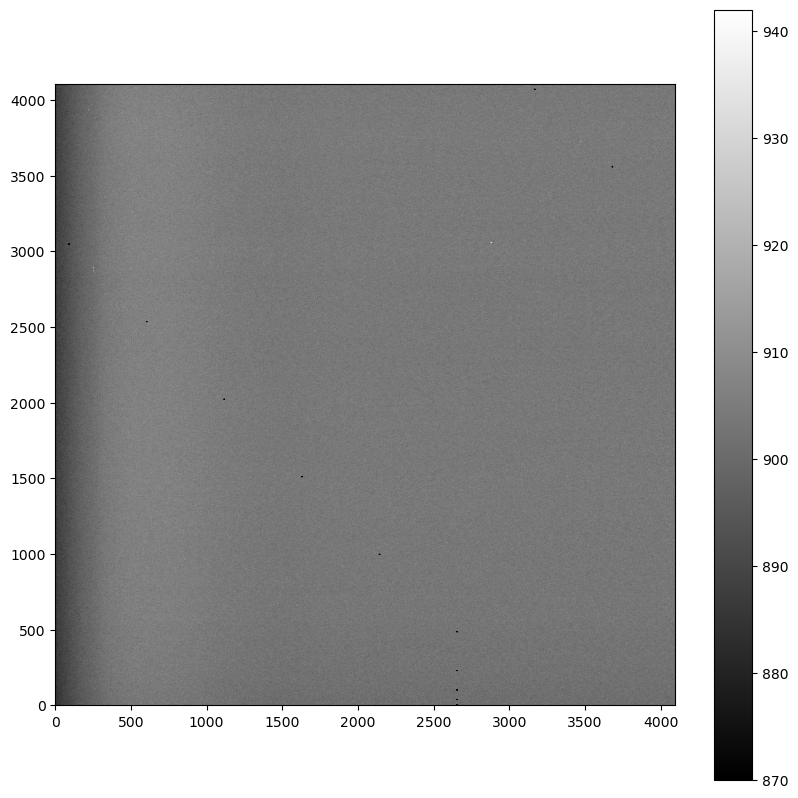

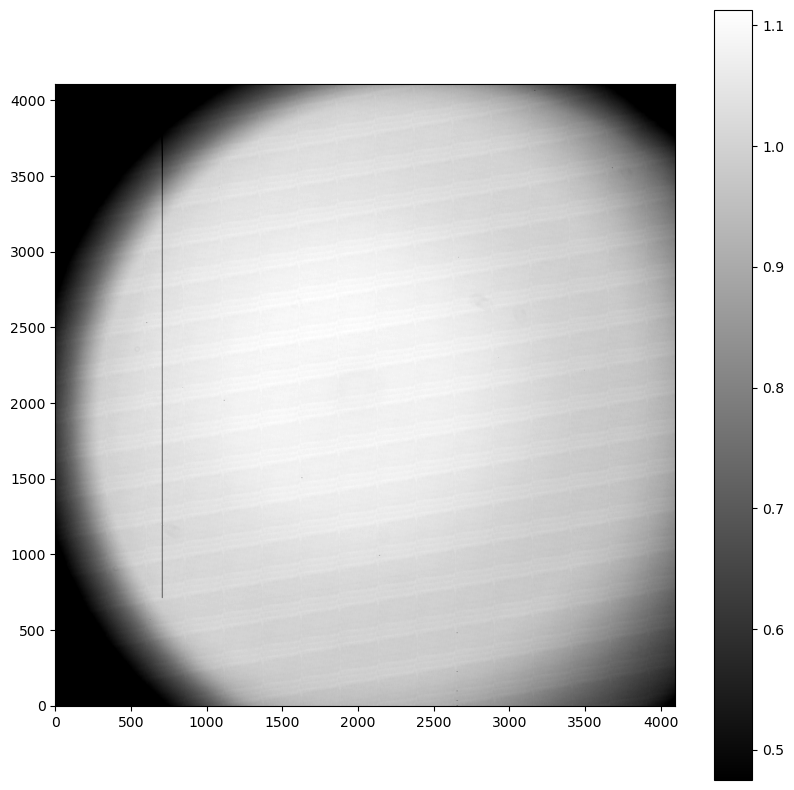

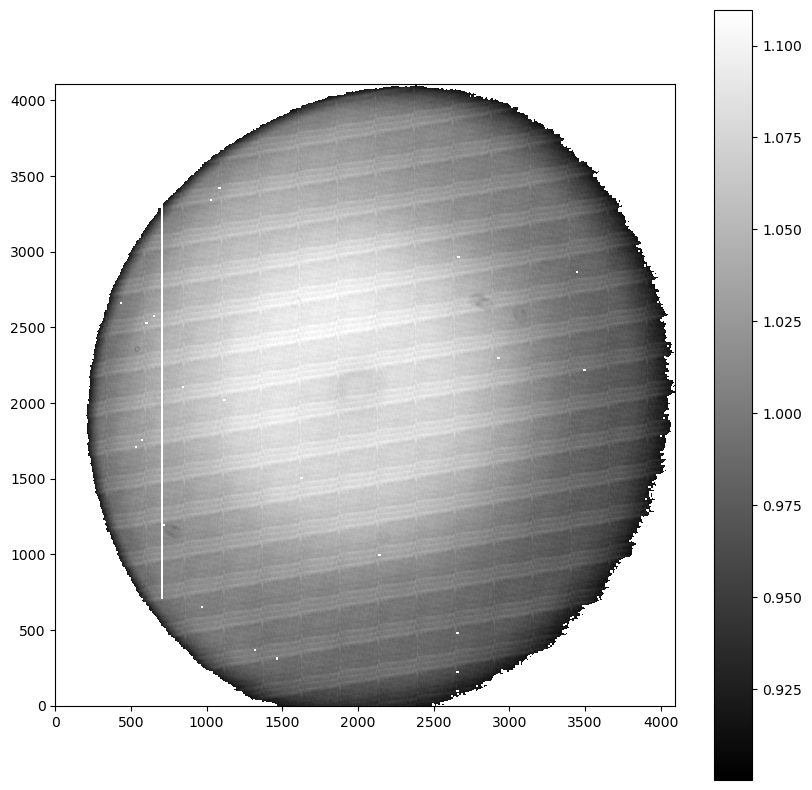

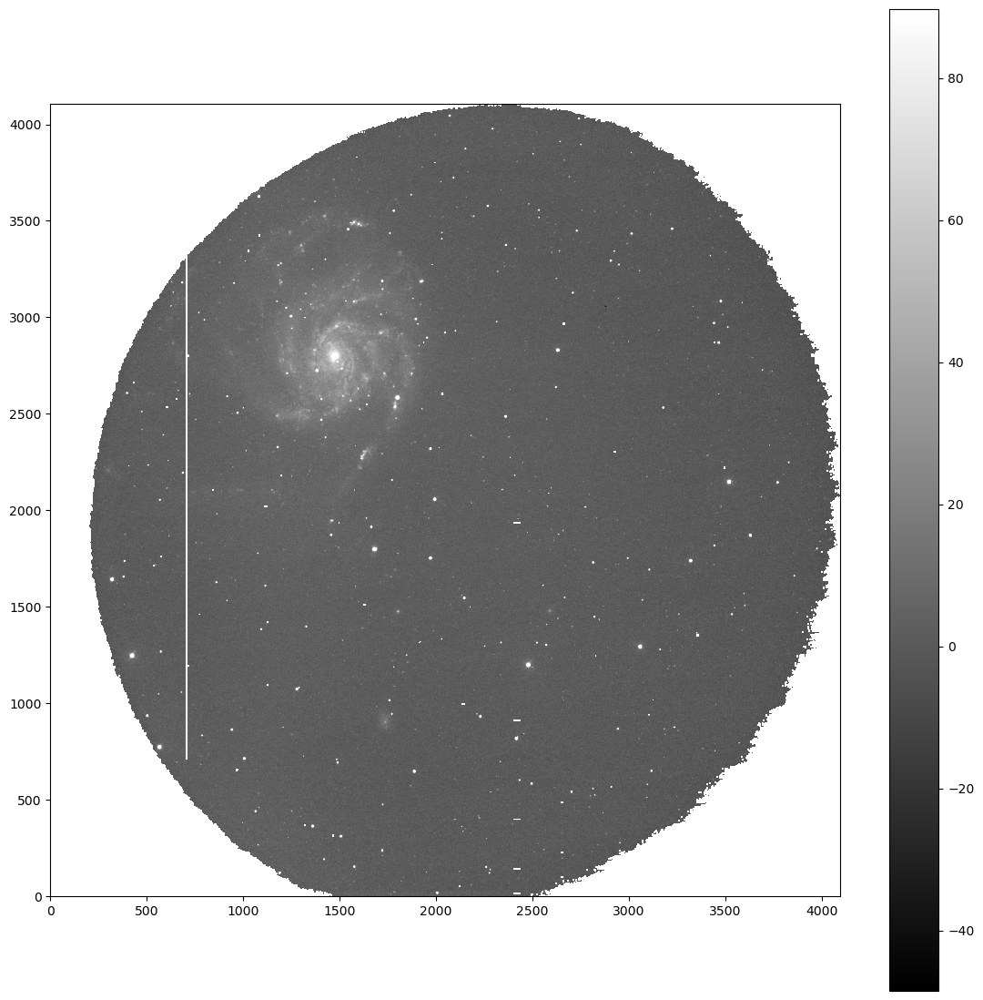

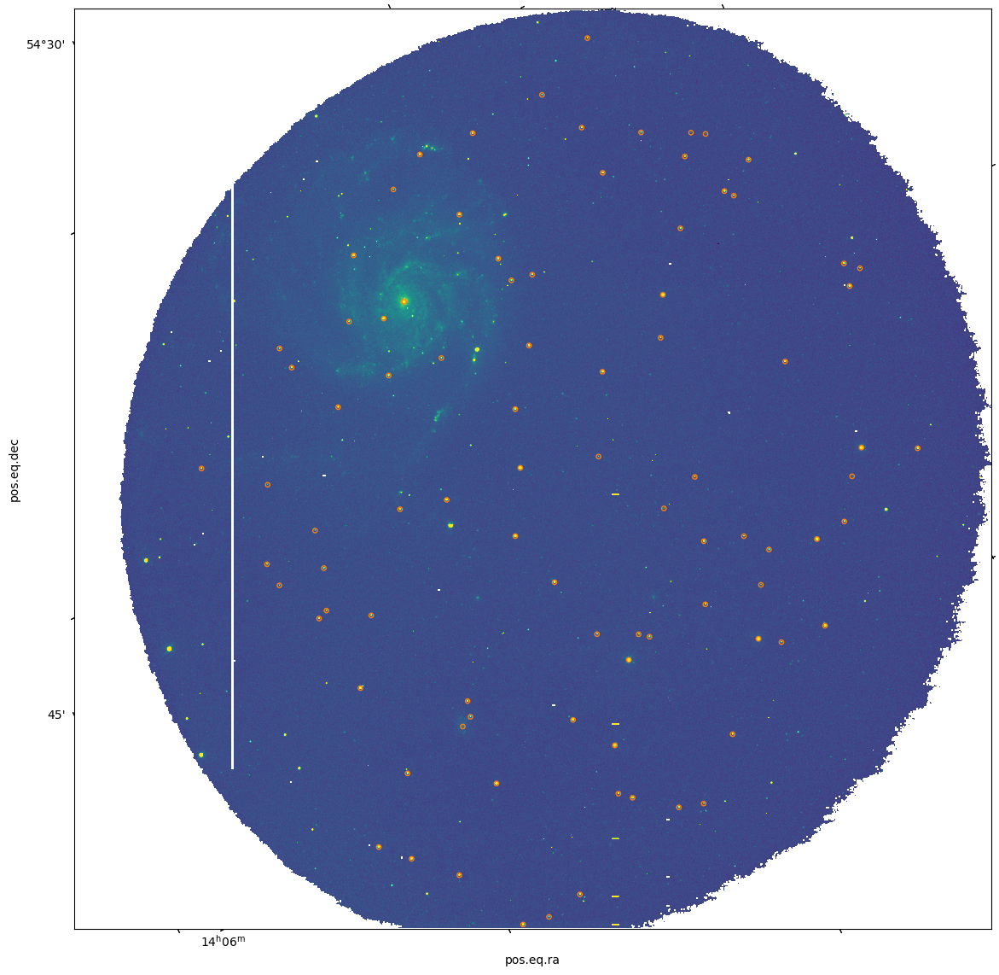

In [30]:
exampleFile = sciList[8]         # The first science image
HDUList = fits.open(exampleFile) # Open the file
HDUList.info()                   # Print some information about the FITS file structure. 
data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.


plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(data)
plt.imshow(data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar() 

## Bias Image


bias_image = biasList[5]
HDUList = fits.open(bias_image)
data = HDUList.info()

bias_data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.

plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(bias_data)
plt.imshow(bias_data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()

## Flat Image

flat_image = flatList[1]
HDUList = fits.open(flat_image)
data = HDUList.info()
flat_data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.

plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(flat_data)
plt.imshow(flat_data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()

## Normalising and displaying Flat Image

flat_corrected  = flat_data 
normfactor = np.median(flat_data)
print(normfactor)
flat_corrected[:,:] = flat_data / normfactor

masterFlatFixed = np.copy(flat_corrected) # Use 'copy' to preserve the original masterFlat
if np.any(flat_corrected < 0.9):
        # Set all flat-field values lower than 0.2 to NaN
        masterFlatFixed[flat_corrected < 0.9] = float('NaN') 

plt.figure(figsize=(10,10))
zx = ZScaleInterval().get_limits(masterFlatFixed)
plt.imshow(masterFlatFixed, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()



HDUList = fits.open(sciList[8])
primaryHeader = HDUList[0].header
imageData = HDUList[0].data    
HDUList.close()
        
        # Correct for the bias and flats here
procData = (imageData - bias_data) / masterFlatFixed
        
        # Prepare the output FITS structure in simple format
procHDU = fits.PrimaryHDU(procData)  # Create a new HDU with the processed image data

        # Write the reduced frame to disk
procHDU.writeto('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230525184701-216-RA.proc.fits', overwrite=True) 

plt.figure(figsize=(14,14))

procHDU = fits.open('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230525184701-216-RA.proc.fits')
procData = procHDU[0].data
procHDU.close()
zx = ZScaleInterval().get_limits(procData)
plt.imshow(procData, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()

from astropy.table import Table
corr2 = fits.open('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/corr2-20230525184701-216-RA.fits')

data = corr2[1].data
table = Table(data)

print(table)

## Plotting Astrometrically Corrected Image

from matplotlib.patches import Circle

astromFile = '/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230525184701-216-RA.proc.fits'

with fits.open(astromFile) as HDUList:
    img = HDUList[0].data
    header = HDUList[0].header

wcsFile = '//Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/wcs-20230525184701-216-RA.fits'
with fits.open(wcsFile) as HDUList:
    header = HDUList[0].header

wcs = WCS(header) # the following obtains the transformation matrix from the header

ra = data['field_ra']
dec = data['field_dec']

# changing the coordinates of reference stars from WCS to pixels using tranformation obtained by solving astrometry
coordsx, coordsy = wcs.all_world2pix(ra, dec, 0) 

patch_list = [Circle((x, y), radius=10, fill=False, ec='C1') for x, y in zip(coordsx, coordsy)]

fig = plt.figure(figsize=(14,14))
ax = plt.subplot(projection=wcs) # changes the coordinate system to WCS
mean, median, std = sigma_clipped_stats(img)

plt.imshow(img, vmin=median-3*std, vmax=median+10*std, origin="lower")

for p in patch_list:
    ax.add_patch(p)

plt.show()


# 20230526152122-558-RA.fits

Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/data/20230526152122-558-RA.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     133   (4096, 4108)   int16 (rescales to uint16)   
Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/bias/20230526_masterbias.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     111   (4096, 4108)   float64   
Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/flat/20230526_masterflat_g_.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     121   (4096, 4108)   float64   
1.0
     field_x            field_y       ...    FLUX   BACKGROUND
------------------ ------------------ ... ---

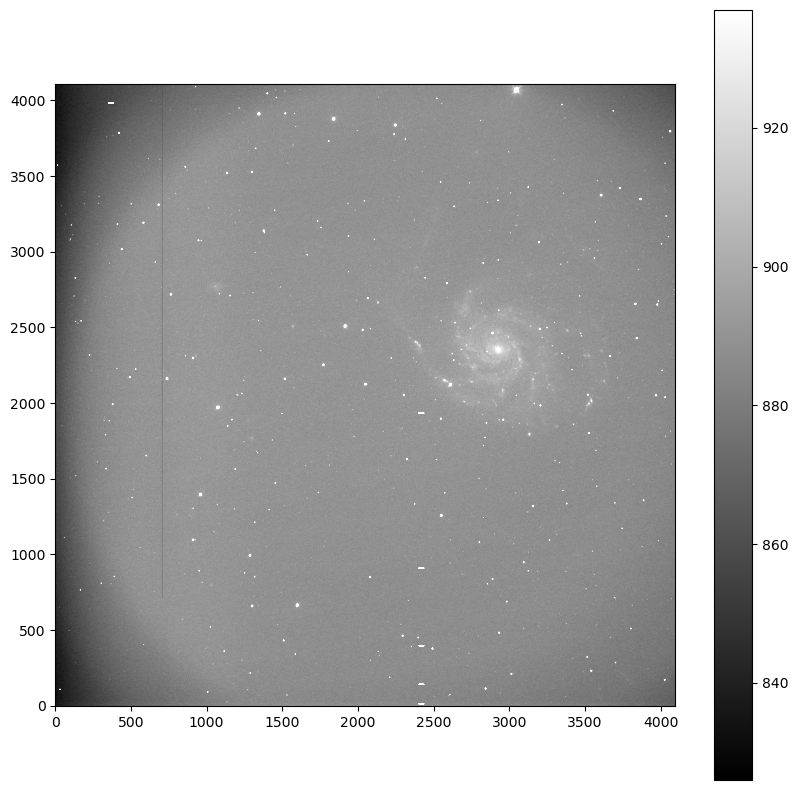

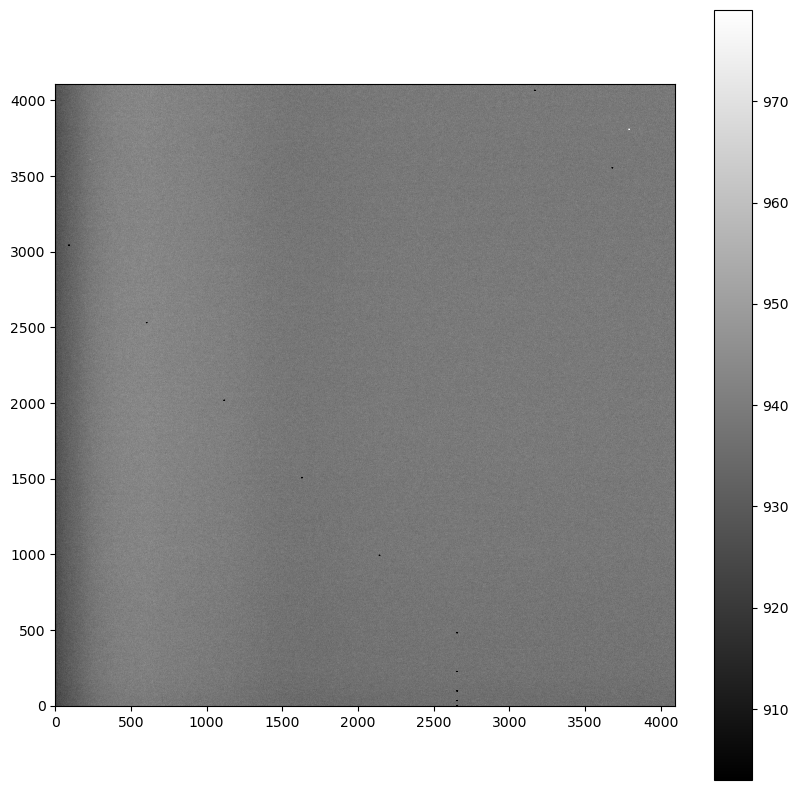

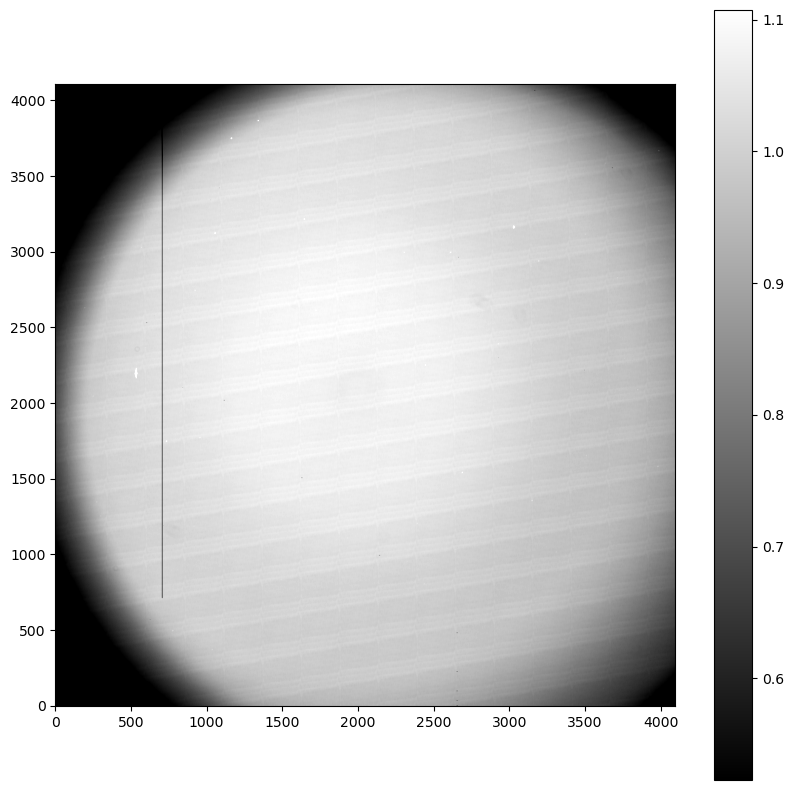

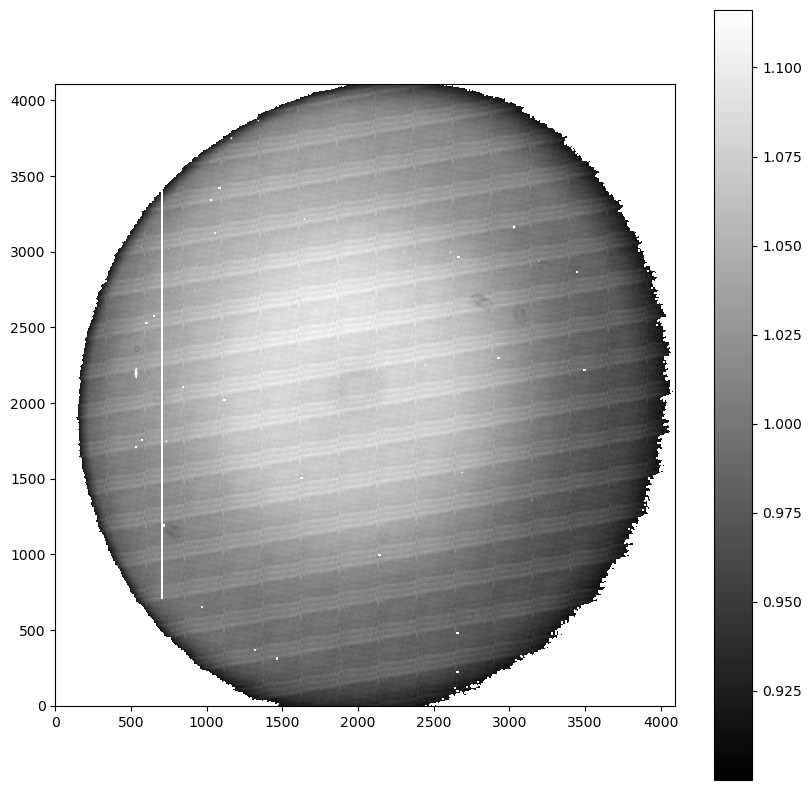

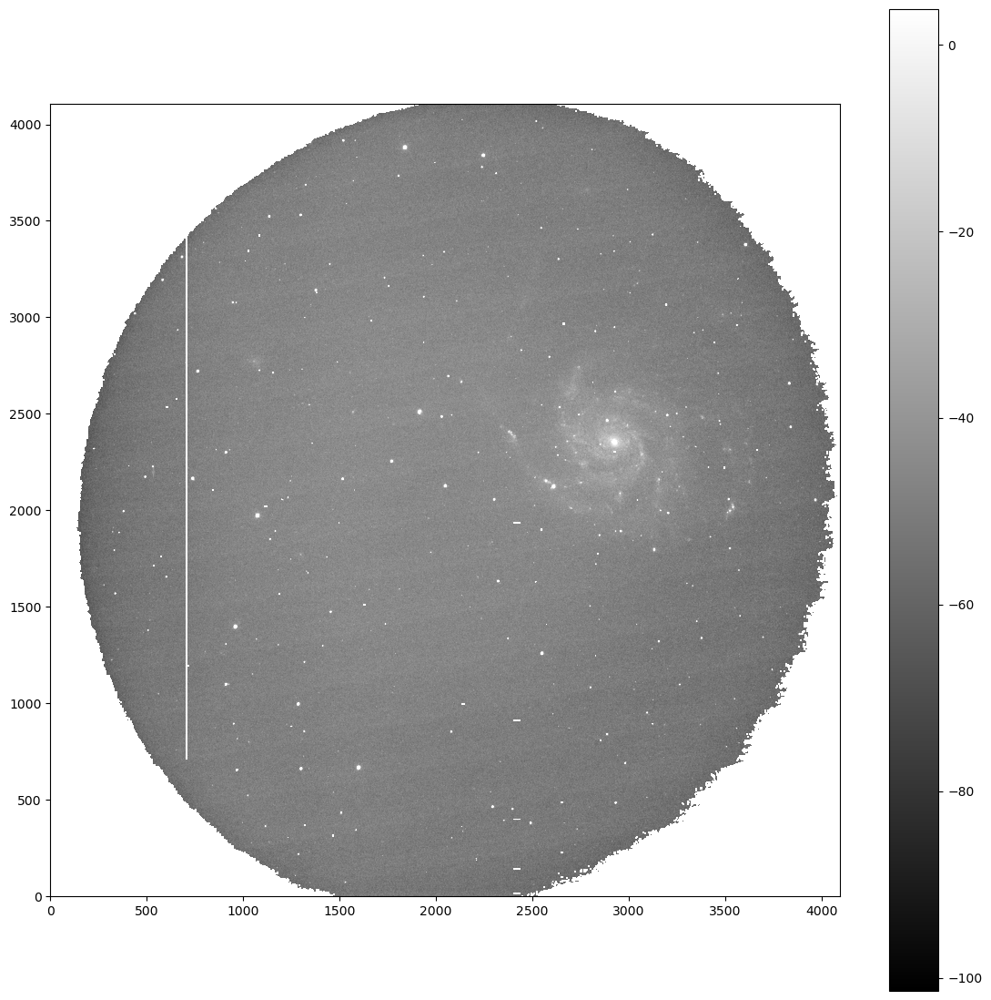

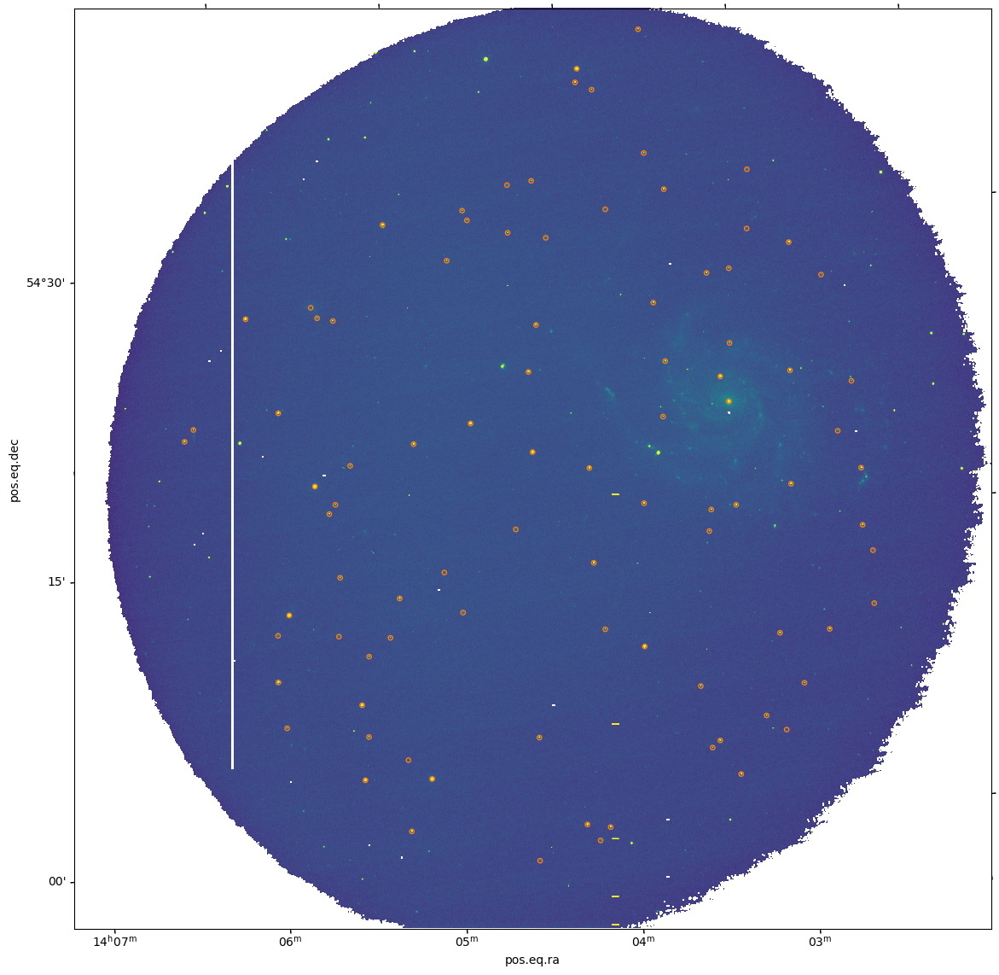

In [31]:
exampleFile = sciList[11]         # The first science image
HDUList = fits.open(exampleFile) # Open the file
HDUList.info()                   # Print some information about the FITS file structure. 
data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.


plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(data)
plt.imshow(data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar() 

## Bias Image


bias_image = biasList[6]
HDUList = fits.open(bias_image)
data = HDUList.info()

bias_data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.

plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(bias_data)
plt.imshow(bias_data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()

## Flat Image

flat_image = flatList[2]
HDUList = fits.open(flat_image)
data = HDUList.info()
flat_data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.

plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(flat_data)
plt.imshow(flat_data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()

## Normalising and displaying Flat Image

flat_corrected  = flat_data 
normfactor = np.median(flat_data)
print(normfactor)
flat_corrected[:,:] = flat_data / normfactor

masterFlatFixed = np.copy(flat_corrected) # Use 'copy' to preserve the original masterFlat
if np.any(flat_corrected < 0.9):
        # Set all flat-field values lower than 0.2 to NaN
        masterFlatFixed[flat_corrected < 0.9] = float('NaN') 

plt.figure(figsize=(10,10))
zx = ZScaleInterval().get_limits(masterFlatFixed)
plt.imshow(masterFlatFixed, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()



HDUList = fits.open(sciList[11])
primaryHeader = HDUList[0].header
imageData = HDUList[0].data    
HDUList.close()
        
        # Correct for the bias and flats here
procData = (imageData - bias_data) / masterFlatFixed
        
        # Prepare the output FITS structure in simple format
procHDU = fits.PrimaryHDU(procData)  # Create a new HDU with the processed image data

        # Write the reduced frame to disk
procHDU.writeto('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230526152122-558-RA.proc.fits', overwrite=True) 

plt.figure(figsize=(14,14))

procHDU = fits.open('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230526152122-558-RA.proc.fits')
procData = procHDU[0].data
procHDU.close()
zx = ZScaleInterval().get_limits(procData)
plt.imshow(procData, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()


from astropy.table import Table
corr2 = fits.open('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/corr2-20230526152122-558-RA.fits')

data = corr2[1].data
table = Table(data)

print(table)

## Plotting Astrometrically Corrected Image

from matplotlib.patches import Circle

astromFile = '/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230526152122-558-RA.proc.fits'

with fits.open(astromFile) as HDUList:
    img = HDUList[0].data
    header = HDUList[0].header

wcsFile = '/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/wcs-20230526152122-558-RA.fits'
with fits.open(wcsFile) as HDUList:
    header = HDUList[0].header

wcs = WCS(header) # the following obtains the transformation matrix from the header

ra = data['field_ra']
dec = data['field_dec']

# changing the coordinates of reference stars from WCS to pixels using tranformation obtained by solving astrometry
coordsx, coordsy = wcs.all_world2pix(ra, dec, 0) 

patch_list = [Circle((x, y), radius=10, fill=False, ec='C1') for x, y in zip(coordsx, coordsy)]

fig = plt.figure(figsize=(14,14))
ax = plt.subplot(projection=wcs) # changes the coordinate system to WCS
mean, median, std = sigma_clipped_stats(img)

plt.imshow(img, vmin=median-3*std, vmax=median+10*std, origin="lower")

for p in patch_list:
    ax.add_patch(p)

plt.show()


# 20230603150337-154-RA.fits

Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/data/20230603150337-154-RA.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     131   (4096, 4108)   int16 (rescales to uint16)   
Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/bias/20230603_masterbias.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     111   (4096, 4108)   float64   
Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/flat/20230603_masterflat_g_.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     121   (4096, 4108)   float64   
1.0


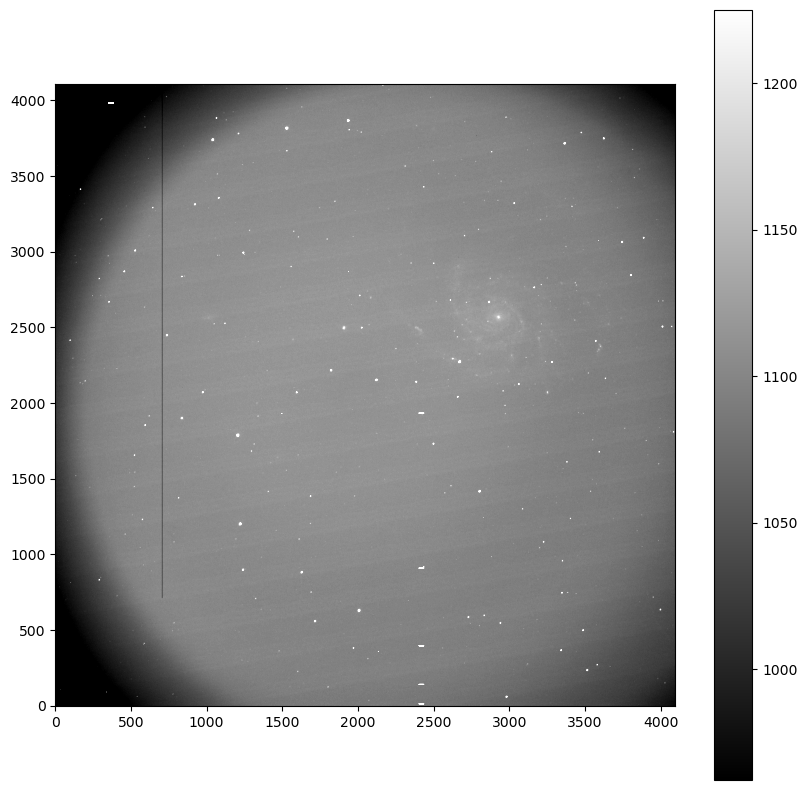

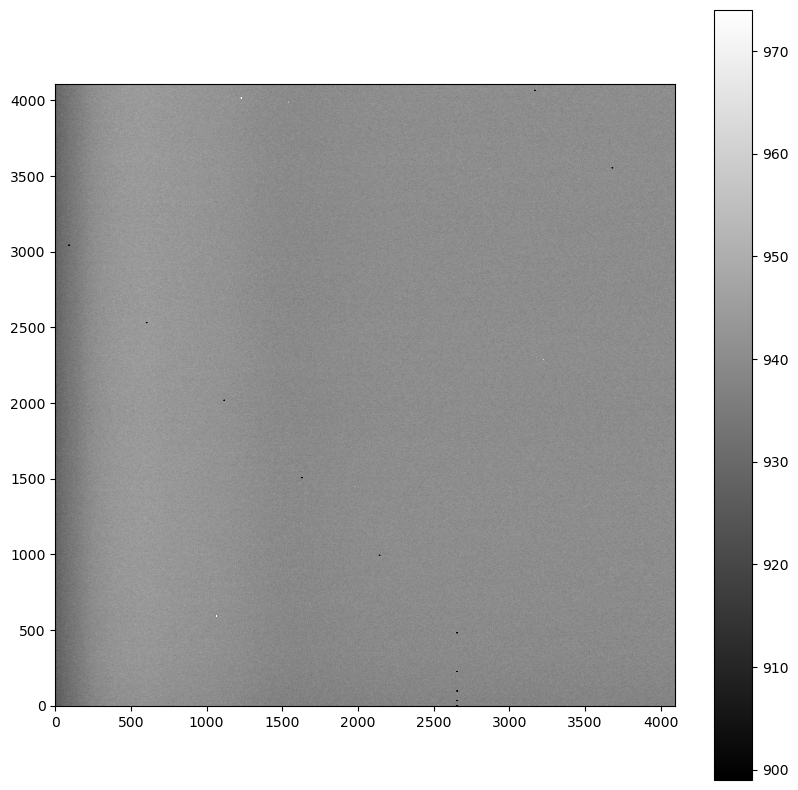

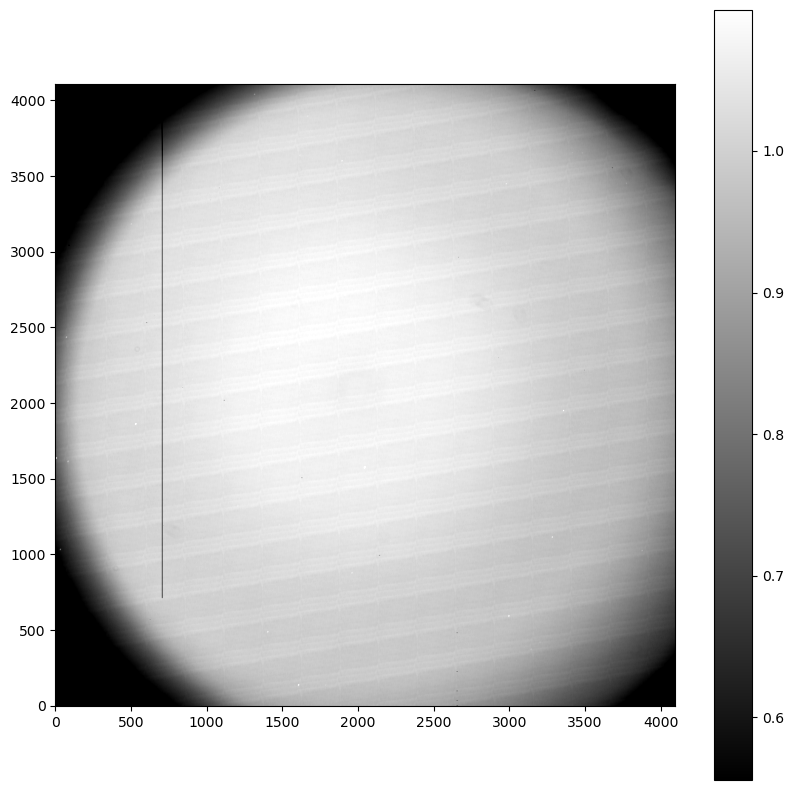

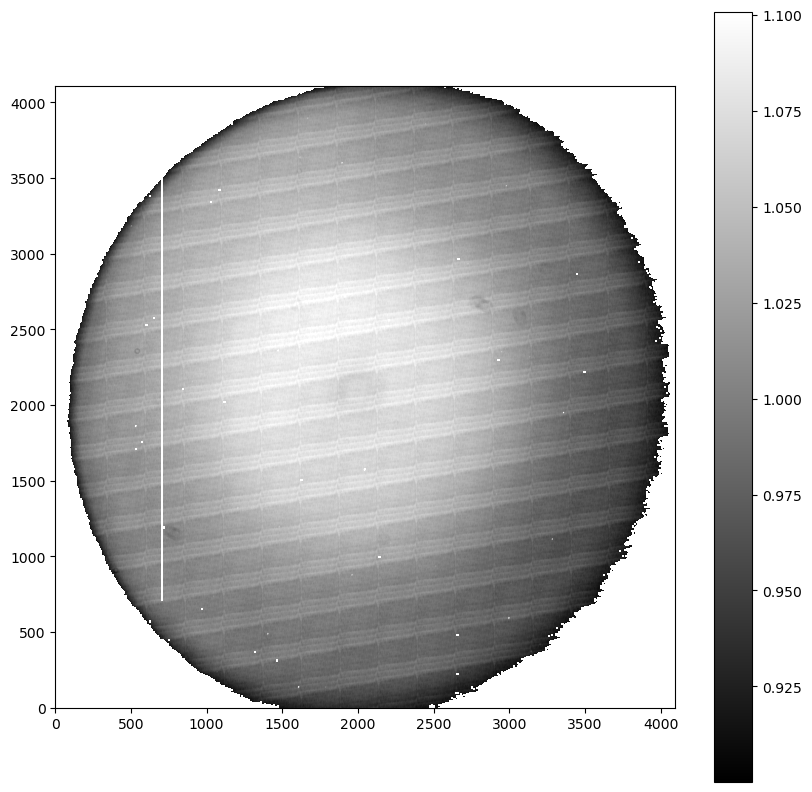

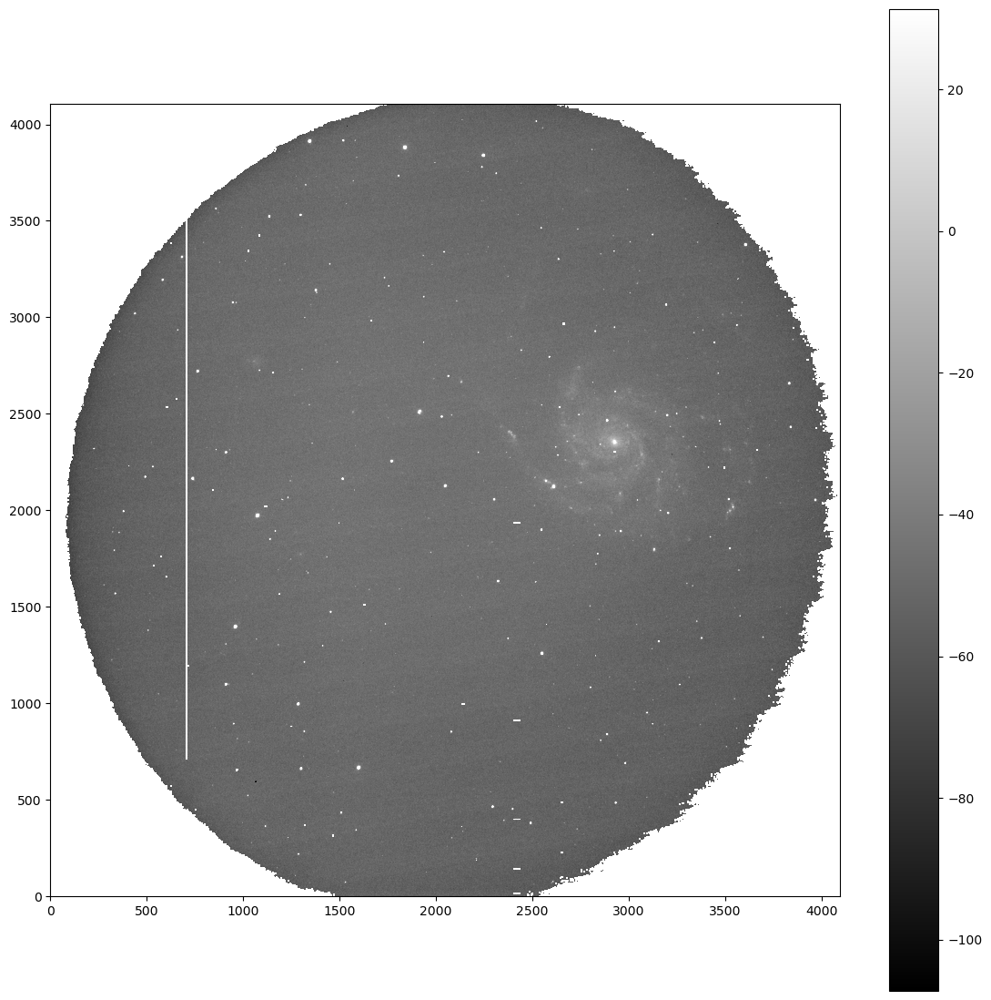

In [22]:
exampleFile = sciList[19]         # The first science image
HDUList = fits.open(exampleFile) # Open the file
HDUList.info()                   # Print some information about the FITS file structure. 
data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.


plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(data)
plt.imshow(data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar() 

## Bias Image


bias_image = biasList[10]
HDUList = fits.open(bias_image)
data = HDUList.info()

bias_data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.

plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(bias_data)
plt.imshow(bias_data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()

## Flat Image

flat_image = flatList[4]
HDUList = fits.open(flat_image)
data = HDUList.info()
flat_data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.

plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(flat_data)
plt.imshow(flat_data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()

## Normalising and displaying Flat Image

flat_corrected  = flat_data 
normfactor = np.median(flat_data)
print(normfactor)
flat_corrected[:,:] = flat_data / normfactor

masterFlatFixed = np.copy(flat_corrected) # Use 'copy' to preserve the original masterFlat
if np.any(flat_corrected < 0.9):
        # Set all flat-field values lower than 0.2 to NaN
        masterFlatFixed[flat_corrected < 0.9] = float('NaN') 

plt.figure(figsize=(10,10))
zx = ZScaleInterval().get_limits(masterFlatFixed)
plt.imshow(masterFlatFixed, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()



HDUList = fits.open(sciList[11])
primaryHeader = HDUList[0].header
imageData = HDUList[0].data    
HDUList.close()
        
        # Correct for the bias and flats here
procData = (imageData - bias_data) / masterFlatFixed
        
        # Prepare the output FITS structure in simple format
procHDU = fits.PrimaryHDU(procData)  # Create a new HDU with the processed image data

        # Write the reduced frame to disk
procHDU.writeto('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230603150337-154-RA.proc.fits', overwrite=True) 

plt.figure(figsize=(14,14))

procHDU = fits.open('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230603150337-154-RA.proc.fits')
procData = procHDU[0].data
procHDU.close()
zx = ZScaleInterval().get_limits(procData)
plt.imshow(procData, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()




# 20230605152158-307-RA.fits

In [23]:
sciList[23]

'/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/data/20230605152158-307-RA.fits'

Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/data/20230605152158-307-RA.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     131   (4096, 4108)   int16 (rescales to uint16)   
Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/bias/20230605_masterbias.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     111   (4096, 4108)   float64   
Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/flat/20230605_masterflat_g_.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     121   (4096, 4108)   float64   
1.0
     field_x            field_y       ...    FLUX   BACKGROUND
------------------ ------------------ ... ---

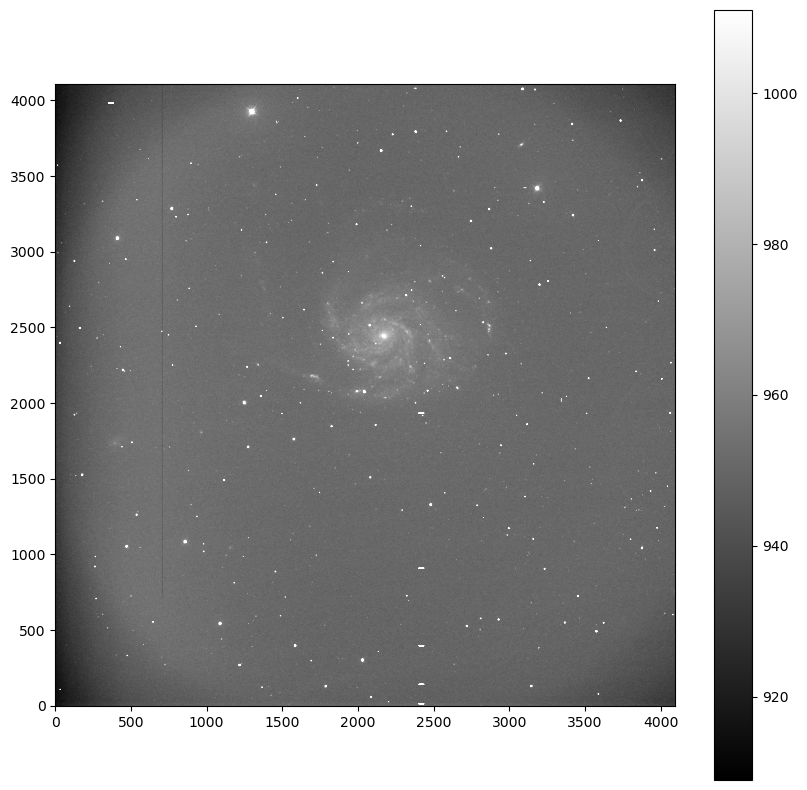

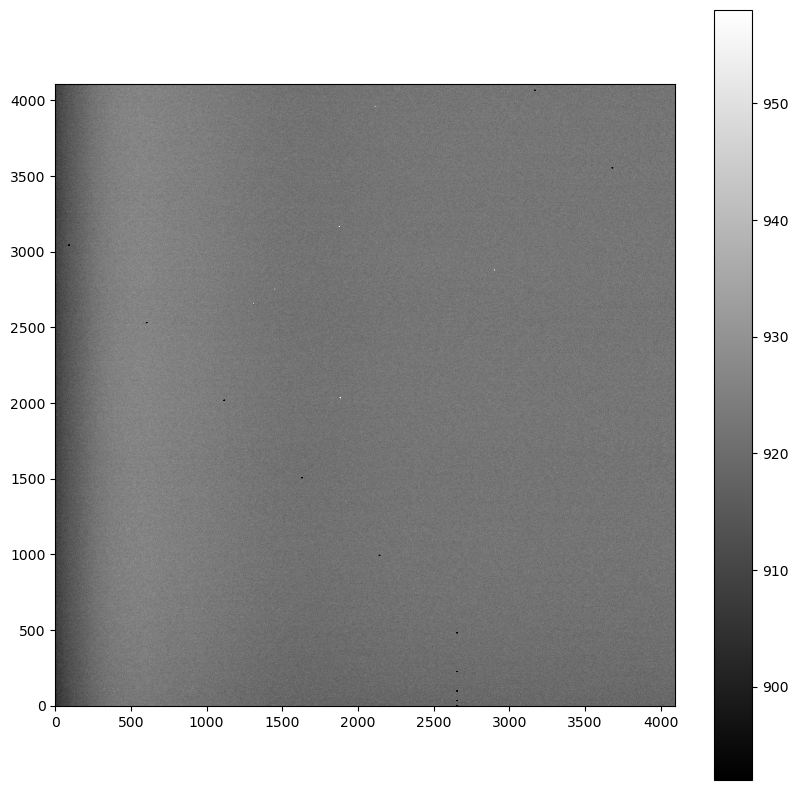

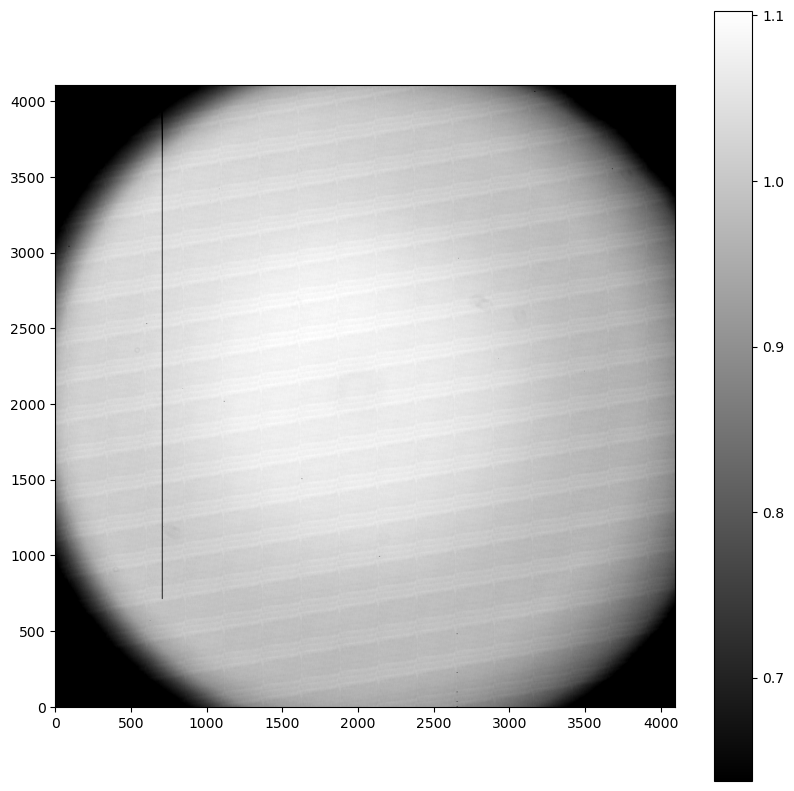

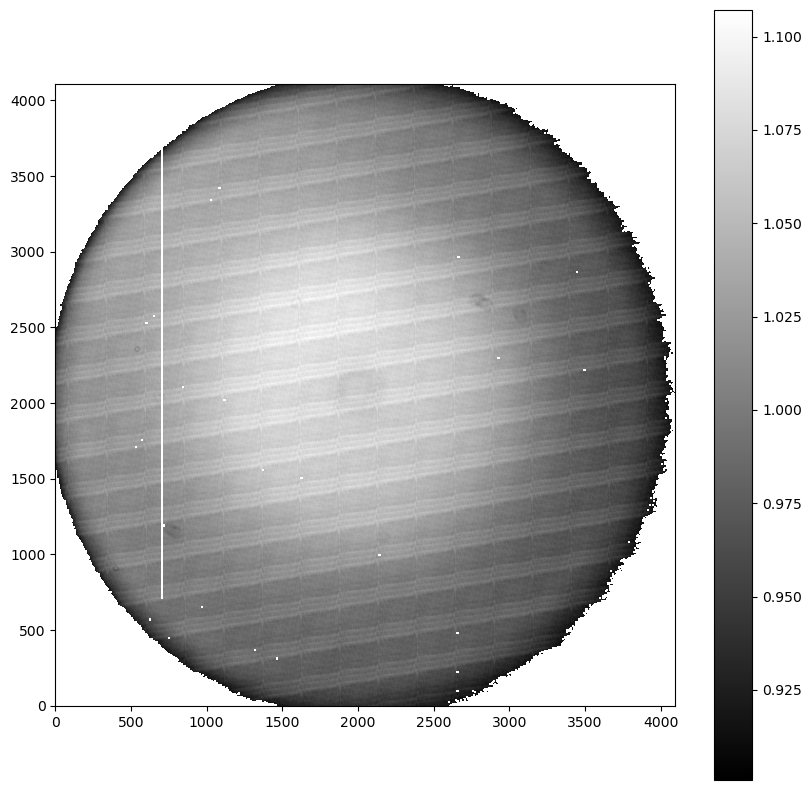

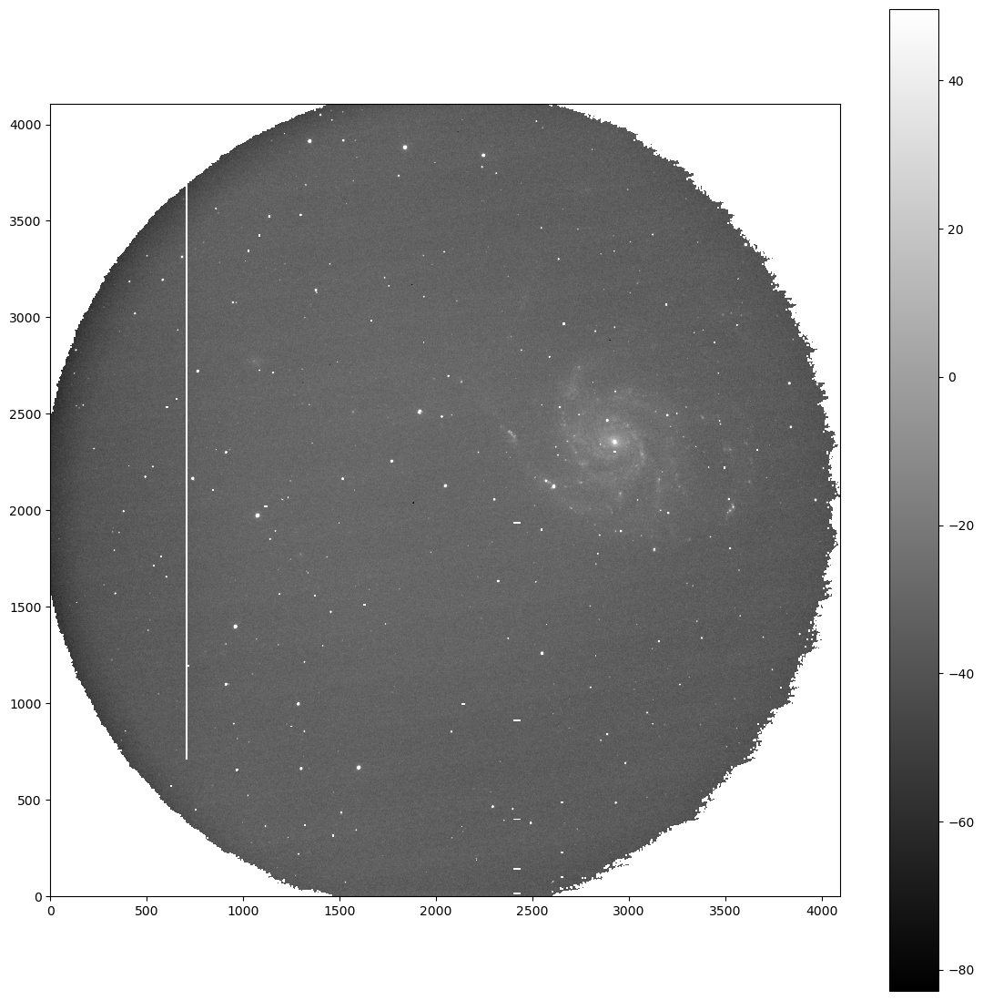

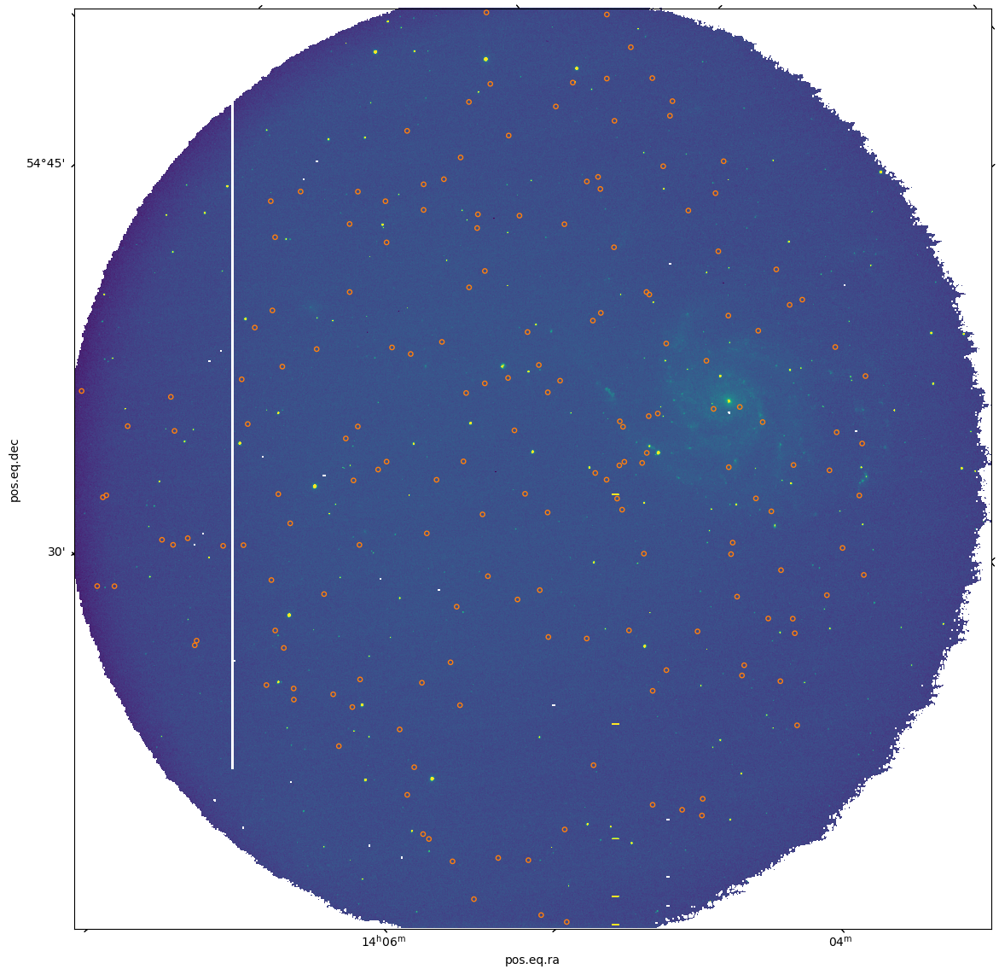

In [32]:
exampleFile = sciList[23]         # The first science image
HDUList = fits.open(exampleFile) # Open the file
HDUList.info()                   # Print some information about the FITS file structure. 
data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.


plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(data)
plt.imshow(data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar() 

## Bias Image


bias_image = biasList[12]
HDUList = fits.open(bias_image)
data = HDUList.info()

bias_data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.

plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(bias_data)
plt.imshow(bias_data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()

## Flat Image

flat_image = flatList[5]
HDUList = fits.open(flat_image)
data = HDUList.info()
flat_data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.

plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(flat_data)
plt.imshow(flat_data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()

## Normalising and displaying Flat Image

flat_corrected  = flat_data 
normfactor = np.median(flat_data)
print(normfactor)
flat_corrected[:,:] = flat_data / normfactor

masterFlatFixed = np.copy(flat_corrected) # Use 'copy' to preserve the original masterFlat
if np.any(flat_corrected < 0.9):
        # Set all flat-field values lower than 0.2 to NaN
        masterFlatFixed[flat_corrected < 0.9] = float('NaN') 

plt.figure(figsize=(10,10))
zx = ZScaleInterval().get_limits(masterFlatFixed)
plt.imshow(masterFlatFixed, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()



HDUList = fits.open(sciList[11])
primaryHeader = HDUList[0].header
imageData = HDUList[0].data    
HDUList.close()
        
        # Correct for the bias and flats here
procData = (imageData - bias_data) / masterFlatFixed
        
        # Prepare the output FITS structure in simple format
procHDU = fits.PrimaryHDU(procData)  # Create a new HDU with the processed image data

        # Write the reduced frame to disk
procHDU.writeto('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230605152158-307-RA.proc.fits', overwrite=True) 

plt.figure(figsize=(14,14))

procHDU = fits.open('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230605152158-307-RA.proc.fits')
procData = procHDU[0].data
procHDU.close()
zx = ZScaleInterval().get_limits(procData)
plt.imshow(procData, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()


from astropy.table import Table
corr2 = fits.open('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/corr2-20230605152158-307-RA.fits')

data = corr2[1].data
table = Table(data)

print(table)

## Plotting Astrometrically Corrected Image

from matplotlib.patches import Circle

astromFile = '/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230605152158-307-RA.proc.fits'

with fits.open(astromFile) as HDUList:
    img = HDUList[0].data
    header = HDUList[0].header

wcsFile = '//Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/wcs-20230605152158-307-RA.fits'
with fits.open(wcsFile) as HDUList:
    header = HDUList[0].header

wcs = WCS(header) # the following obtains the transformation matrix from the header

ra = data['field_ra']
dec = data['field_dec']

# changing the coordinates of reference stars from WCS to pixels using tranformation obtained by solving astrometry
coordsx, coordsy = wcs.all_world2pix(ra, dec, 0) 

patch_list = [Circle((x, y), radius=10, fill=False, ec='C1') for x, y in zip(coordsx, coordsy)]

fig = plt.figure(figsize=(14,14))
ax = plt.subplot(projection=wcs) # changes the coordinate system to WCS
mean, median, std = sigma_clipped_stats(img)

plt.imshow(img, vmin=median-3*std, vmax=median+10*std, origin="lower")

for p in patch_list:
    ax.add_patch(p)

plt.show()

## 20230522154624-727-RA.fits

Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/data/20230522154624-727-RA.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     133   (4096, 4108)   int16 (rescales to uint16)   
Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/bias/20230522_masterbias.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     111   (4096, 4108)   float64   
Filename: /Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/flat/masterflat_g_.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     121   (4096, 4108)   float64   
1.0
/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band

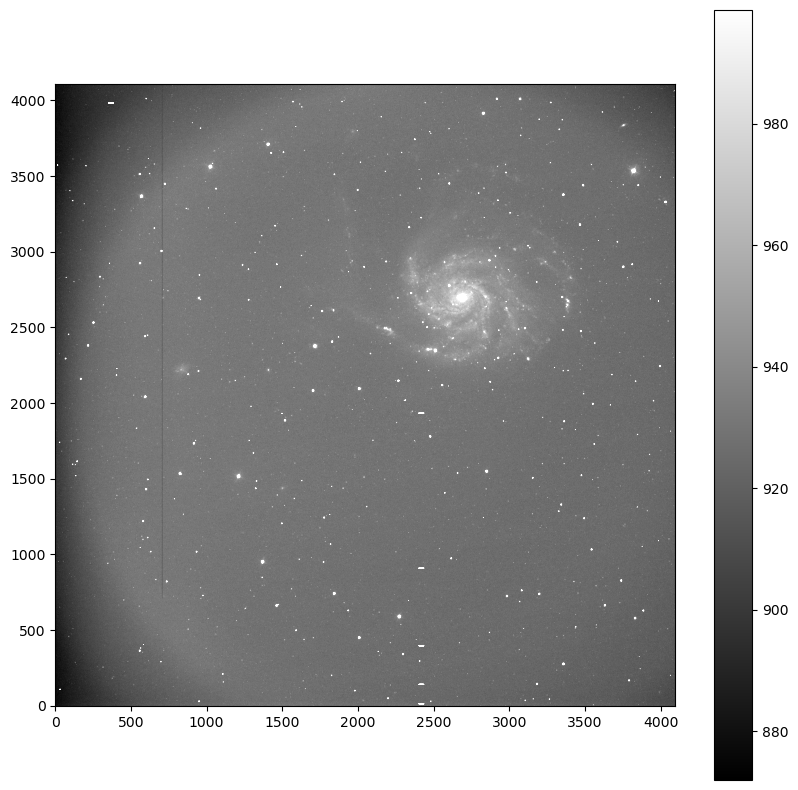

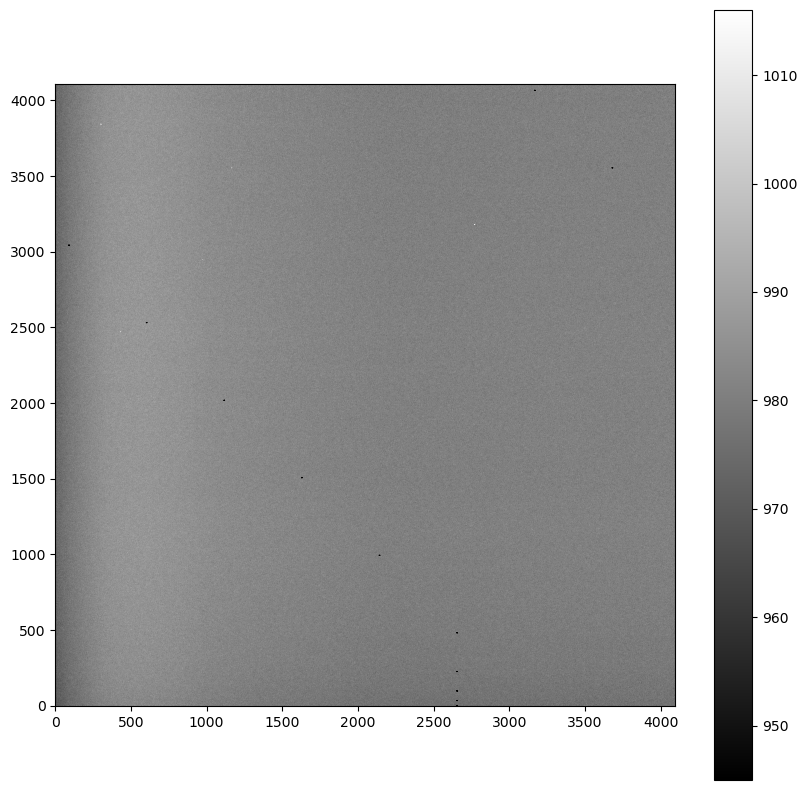

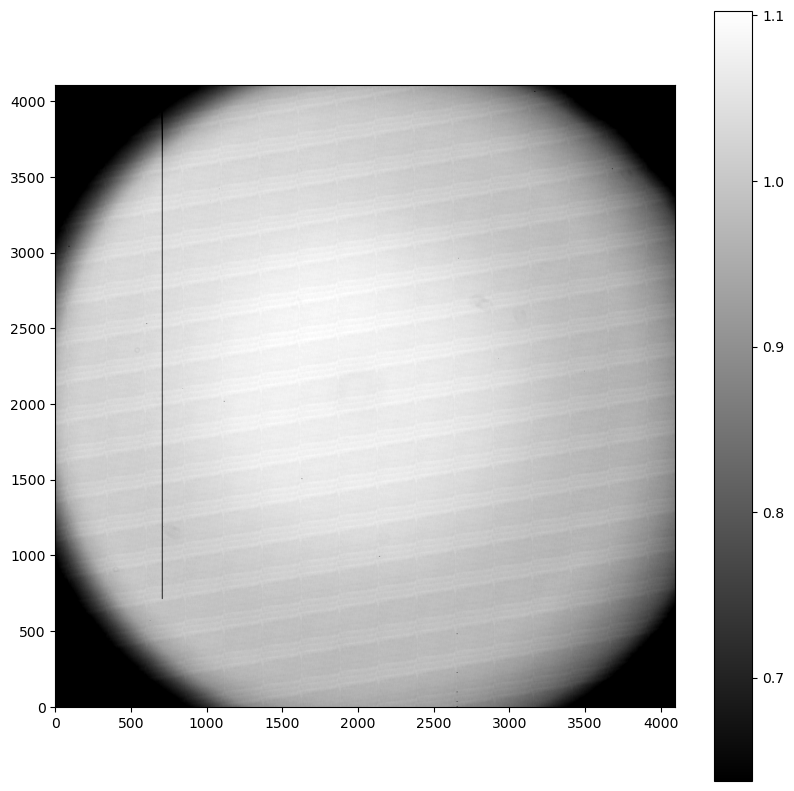

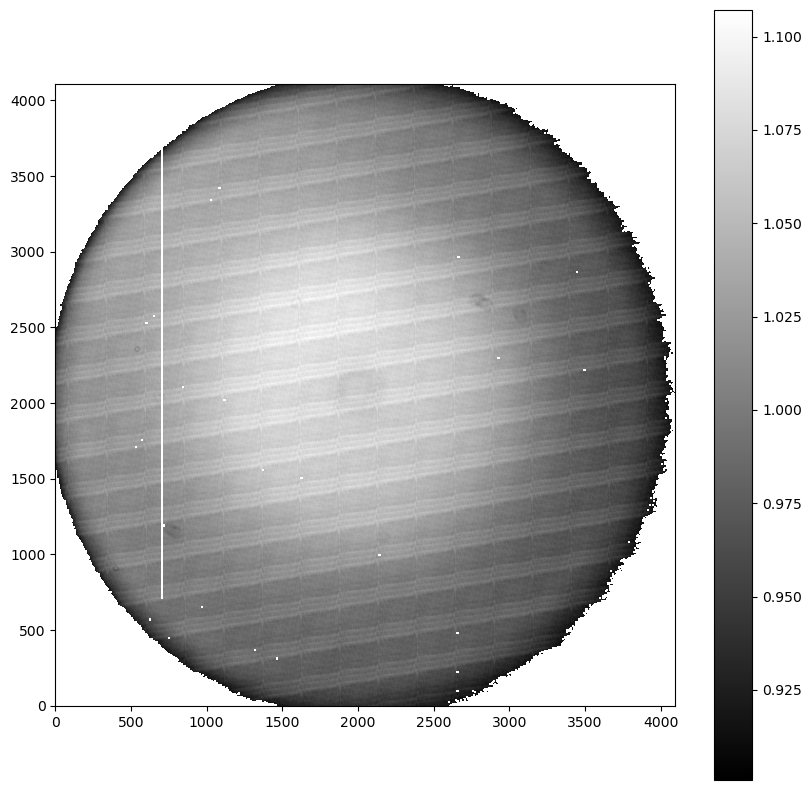

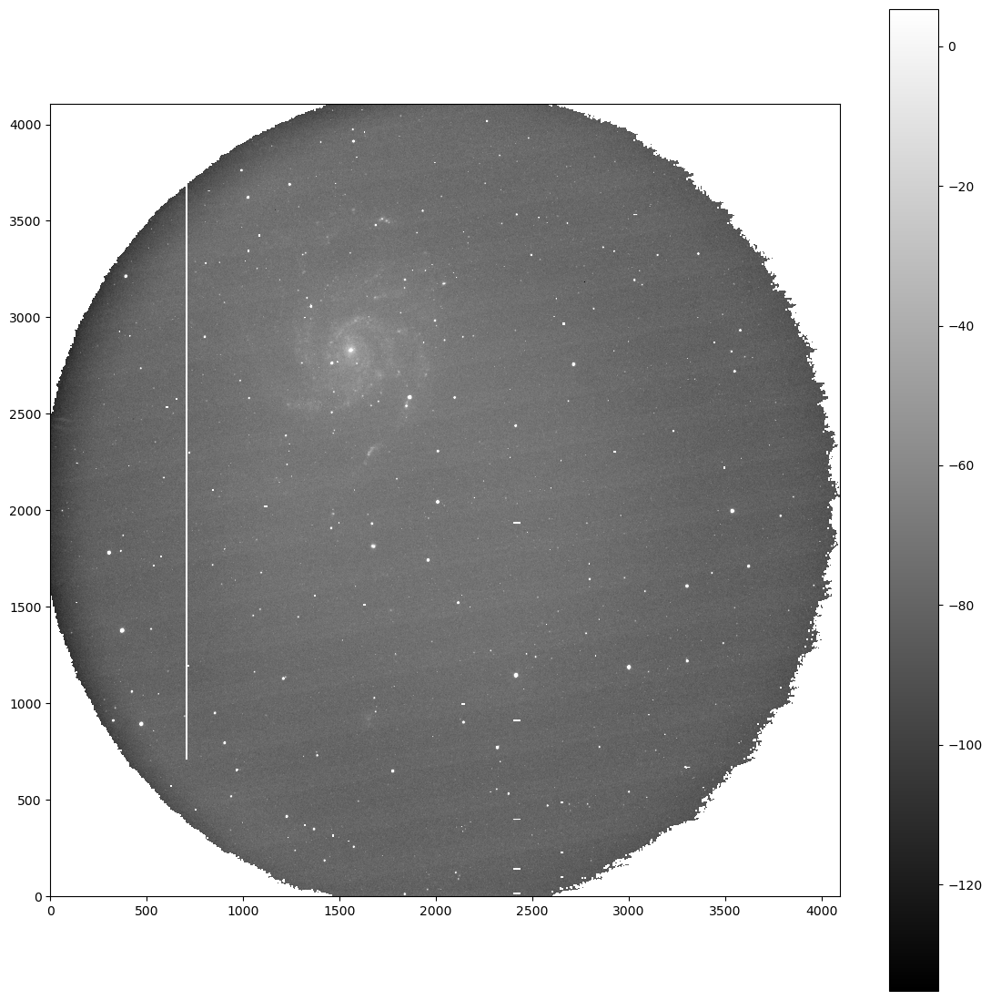

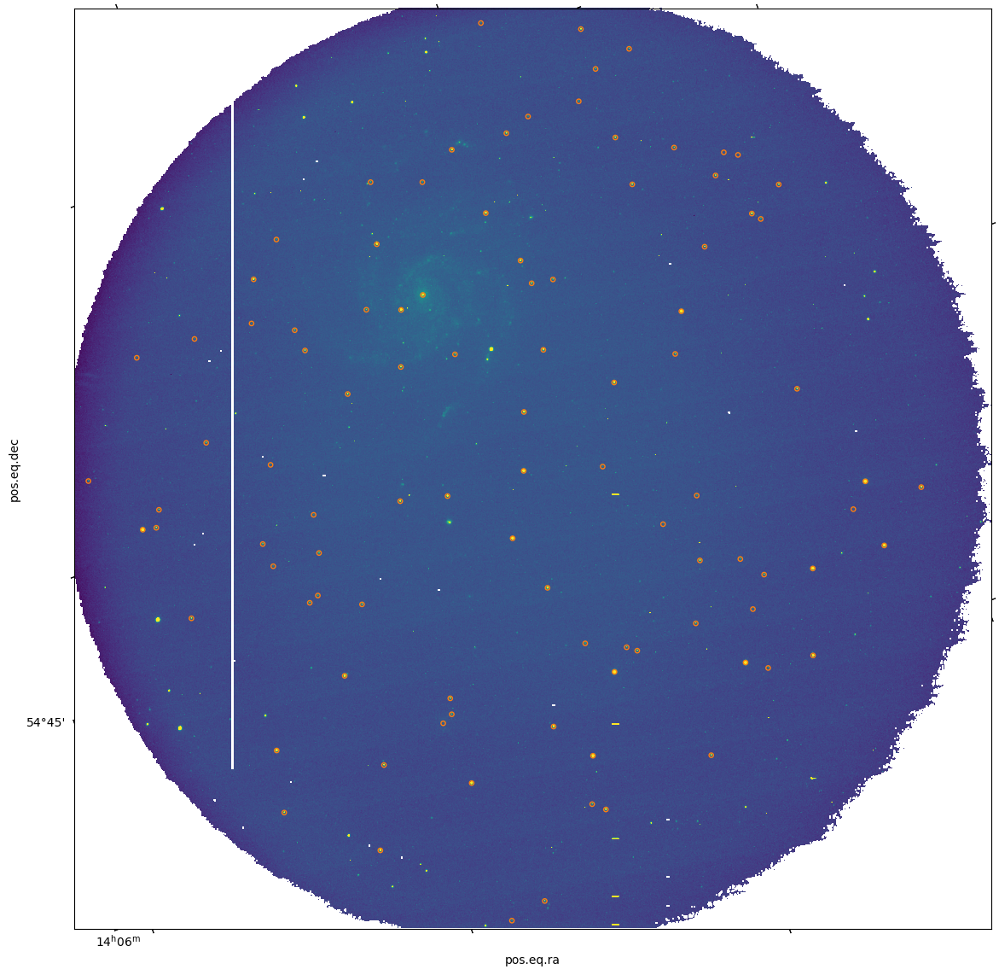

In [7]:
exampleFile = sciList[4]         # The first science image
HDUList = fits.open(exampleFile) # Open the file
HDUList.info()                   # Print some information about the FITS file structure. 
data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.


plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(data)
plt.imshow(data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar() 

## Bias Image


bias_image = biasList[2]
HDUList = fits.open(bias_image)
data = HDUList.info()

bias_data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.

plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(bias_data)
plt.imshow(bias_data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()

## Flat Image

flat_image = flatList[-1]
HDUList = fits.open(flat_image)
data = HDUList.info()
flat_data = HDUList[0].data  # Get the data array (a simple numpy array) from the first extension.

plt.figure(figsize=(10,10))                     # set up the plot panel
zx = ZScaleInterval().get_limits(flat_data)
plt.imshow(flat_data, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()

## Normalising and displaying Flat Image

flat_corrected  = flat_data 
normfactor = np.median(flat_data)
print(normfactor)
flat_corrected[:,:] = flat_data / normfactor

masterFlatFixed = np.copy(flat_corrected) # Use 'copy' to preserve the original masterFlat
if np.any(flat_corrected < 0.9):
        # Set all flat-field values lower than 0.2 to NaN
        masterFlatFixed[flat_corrected < 0.9] = float('NaN') 

plt.figure(figsize=(10,10))
zx = ZScaleInterval().get_limits(masterFlatFixed)
plt.imshow(masterFlatFixed, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()



HDUList = fits.open(sciList[6])
primaryHeader = HDUList[0].header
imageData = HDUList[0].data    
HDUList.close()
        
        # Correct for the bias and flats here
procData = (imageData - bias_data) / masterFlatFixed
        
        # Prepare the output FITS structure in simple format
procHDU = fits.PrimaryHDU(procData)  # Create a new HDU with the processed image data

        # Write the reduced frame to disk
print(sciList[6],'->',procList[6])
fits.writeto('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230522154624-727-RA.proc.fits', procData ,overwrite=True) 

plt.figure(figsize=(14,14))

procHDU = fits.open('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230522154624-727-RA.proc.fits')
procData = procHDU[0].data
procHDU.close()
zx = ZScaleInterval().get_limits(procData)
plt.imshow(procData, cmap = 'gray',vmin = zx[0], vmax = zx[1], origin='lower')
plt.colorbar()


## Astrometry

from astropy.table import Table
corr2 = fits.open('/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/corr2-20230522154624-727-RA.fits')

data = corr2[1].data
table = Table(data)

print(table)

## Plotting Astrometrically Corrected Image

from matplotlib.patches import Circle

astromFile = '/Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/20230522154624-727-RA.proc.fits'

with fits.open(astromFile) as HDUList:
    img = HDUList[0].data
    header = HDUList[0].header

wcsFile = '//Users/divyansh/Documents/Research_Projects/KSP/ksp5-selection-assignment-HIGGS317/SN-2023-ixxf/SN-2023-g-band/g_band/processing/wcs-20230522154624-727-RA.fits'
with fits.open(wcsFile) as HDUList:
    header = HDUList[0].header

wcs = WCS(header) # the following obtains the transformation matrix from the header

ra = data['field_ra']
dec = data['field_dec']

# changing the coordinates of reference stars from WCS to pixels using tranformation obtained by solving astrometry
coordsx, coordsy = wcs.all_world2pix(ra, dec, 0) 

patch_list = [Circle((x, y), radius=10, fill=False, ec='C1') for x, y in zip(coordsx, coordsy)]

fig = plt.figure(figsize=(14,14))
ax = plt.subplot(projection=wcs) # changes the coordinate system to WCS
mean, median, std = sigma_clipped_stats(img)

plt.imshow(img, vmin=median-3*std, vmax=median+10*std, origin="lower")

for p in patch_list:
    ax.add_patch(p)

plt.show()